In [19]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from itertools import combinations
import csv
from scipy.signal import resample_poly
import umap
from scipy.stats import pearsonr
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from pathlib import Path
import glob
import shutil
import os
import pickle


import sys
sys.path.append('/storage3/eva/code/remapping/src')
import path_formatting as pf
import motive
import oe
import utils
import myumap

In [21]:
date = "20250909"
animal = "eb03"

help(utils.path_load)

Help on function path_load in module utils:

path_load(date, animal, p=True)
    returns dat_path, ks_path, csv_path, res_path



In [23]:
_, ks_path, csv_path, res_path = utils.path_load(date, animal,p=True)

pa_path = Path(res_path) / "pa" 
pa_path.mkdir(parents=True, exist_ok=True)

Ola! For folders inside of res_path: Path(res_path)/"folder_name"
To make new folder (if not exist): your_path.mkdir(parents=True, exist_ok=True)


In [3]:
goodspiketimes = oe.ks_load(ks_path)
res_path_path = Path(res_path)
with open(Path(res_path) / f"preprocessing/behav_periods_{animal}_{date}.pkl", "rb") as f:
    periods = pickle.load(f)

Sup! U have...
67 phy-good clusters


In [4]:
csv_dict = motive.get_csv_dict(csv_path)
with open(Path(f'{res_path}/preprocessing') / f"meta_{date}.pkl", "rb") as f:
    meta = pickle.load(f)
meta

{'of1': '20250909_1', 'of2': '20250909_2', 'of3': '20250909_3'}

In [5]:
of_keys = list(meta.keys())

In [6]:
spikes_by_periods = {}

for of in of_keys:
    start, end = periods[of]

    spikes_by_periods[of] = {}
    for unit in goodspiketimes.keys():
        spikes = goodspiketimes[unit]
        spikes_in_trial = spikes[(spikes >= start) & (spikes <= end)] - start
        spikes_by_periods[of][unit] = spikes_in_trial

In [7]:
with open(Path(res_path) / f"unit_classes_{date}.pkl", "rb") as f:
    unit_class_dict = pickle.load(f)

In [11]:
uoi = list(goodspiketimes.keys())
pyr = [u for u in uoi if unit_class_dict[u] == "pyr"]
inter = [u for u in uoi if unit_class_dict[u] == "int"]

In [ ]:
# THIS ONE RUN ONLY FIRST TIME

# # sliding 300ms window with 100ms step

# def accumarray(spike_times_dict, sampling_rate=30000, bin_size_ms=300, step_size_ms=100):
#     bin_size = int(bin_size_ms / 1000 * sampling_rate)
#     step_size = int(step_size_ms / 1000 * sampling_rate)

#     # Get all spike times to determine bin range
#     max_time = max([np.max(spikes) if len(spikes) > 0 else 0 for spikes in spike_times_dict.values()])
#     bin_starts = np.arange(0, max_time - bin_size + 1, step_size)
#     n_bins = len(bin_starts)
#     cell_ids = sorted(spike_times_dict.keys())
#     n_cells = len(cell_ids)

#     # Initialize output matrix: (n_cells, n_bins)
#     spike_matrix = np.zeros((n_cells, n_bins), dtype=int)

#     for i, cell_id in enumerate(cell_ids):
#         spikes = np.array(spike_times_dict[cell_id])
#         for j, start in enumerate(bin_starts):
#             end = start + bin_size
#             spike_matrix[i, j] = np.sum((spikes >= start) & (spikes < end))

#     # Bin centers in seconds
#     bin_centers_sec = (bin_starts + bin_size // 2) / sampling_rate
#     return spike_matrix, bin_centers_sec, cell_ids

# spike_matrix = {}
# bin_centers_sec = {}
# cell_ids = {}

# for of in of_keys:
#     spike_matrix[of], bin_centers_sec[of], cell_ids[of] = accumarray(spikes_by_periods[of])

# accumarray4umap = {}
# accumarray4umap['spike_matrix'] = spike_matrix
# accumarray4umap['bin_centers_sec'] = bin_centers_sec
# accumarray4umap['cell_ids'] = cell_ids

# with open(f"{pa_path}/accumarray4umap_{date}.pkl", "wb") as f:
#     pickle.dump(accumarray4umap, f)

In [8]:
with open(f'{pa_path}/accumarray4umap_extended_{date}.pkl', "rb") as f:
    accumarray4umap = pickle.load(f)


spike_matrix = accumarray4umap['spike_matrix']
bin_centers_sec = accumarray4umap['bin_centers_sec']
cell_ids = accumarray4umap['cell_ids']

### Positional data

In [9]:
pos_data_interp = {}
frame_times_all = {}

for k in meta.keys():
    df = csv_dict[meta[k]]
    frame_times_all[k] = motive.get_frame_times(df)
    _, arrays_interpol = motive.get_arrays(df, metric='Position', dim_array = ['X','Y','Z'], interpolate=True)
    pos_data_interp[k]=arrays_interpol

In [10]:
pos_data_interp

{'of1': {'X': array([-0.21342 , -0.213077, -0.2129  , ...,  0.271613,  0.270108,
          0.268767], shape=(216461,)),
  'Y': array([0.23141 , 0.231197, 0.230734, ..., 0.047345, 0.046246, 0.045857],
        shape=(216461,)),
  'Z': array([ 0.524377,  0.523083,  0.521538, ..., -0.436656, -0.432427,
         -0.428121], shape=(216461,))},
 'of2': {'X': array([0.458419, 0.458299, 0.457999, ..., 0.399742, 0.39969 , 0.39963 ],
        shape=(216105,)),
  'Y': array([0.164959, 0.164797, 0.164944, ..., 0.070672, 0.070572, 0.070475],
        shape=(216105,)),
  'Z': array([-0.150357, -0.151077, -0.151704, ..., -0.221752, -0.221671,
         -0.221585], shape=(216105,))},
 'of3': {'X': array([-0.124354, -0.124446, -0.12482 , ...,  0.229951,  0.229993,
          0.229933], shape=(199120,)),
  'Y': array([0.041004, 0.040866, 0.041856, ..., 0.098496, 0.098662, 0.098614],
        shape=(199120,)),
  'Z': array([-0.359722, -0.359626, -0.35956 , ..., -0.381331, -0.381145,
         -0.380952], shape=

In [11]:
pos_data_interp['of1']['X'].shape, pos_data_interp['of1']['Z'].shape

((216461,), (216461,))

In [12]:
with open(Path(res_path) / "preprocessing" / f"smooth_pitch_dict_{date}.pkl", "rb") as f:
    smooth_pitch_dict = pickle.load(f)
smooth_pitch_dict

{'sigma': 3,
 'of1': array([-17.4187444 , -17.00706316, -16.22215051, ...,  57.18881812,
         57.39352354,  57.51169496], shape=(216461,)),
 'of2': array([-12.95793076, -12.85555163, -12.64896105, ...,  50.19739546,
         50.23405673,  50.25504994], shape=(216105,)),
 'of3': array([69.06128936, 69.04429867, 68.99513741, ..., 62.37139323,
        62.33214017, 62.31941676], shape=(199120,))}

In [13]:
fs_pos = 120 # Motive sampling rate in Hz

In [14]:
pos_data_resampled = {}
pitch_resampled = {}

for of in of_keys:
    print(of)
    pitch_resampled[of] = np.interp(
                bin_centers_sec[of], 
                np.arange(len(smooth_pitch_dict[of]))/fs_pos, 
                smooth_pitch_dict[of]
                )*(-1) # here I flip pitch
    print(pitch_resampled[of].shape)
    
    pd_res = {}
    for dim in pos_data_interp[of].keys():
        pd_res[dim] = np.interp(
            bin_centers_sec[of], 
            np.arange(len(pos_data_interp[of][dim]))/fs_pos, 
            pos_data_interp[of][dim]
            )
        print(pd_res[dim].shape)
    pos_data_resampled[of] = pd_res


of1
(18036,)
(18036,)
(18036,)
(18036,)
of2
(18006,)
(18006,)
(18006,)
(18006,)
of3
(16591,)
(16591,)
(16591,)
(16591,)


In [15]:
pos_data_resampled

{'of1': {'X': array([-0.20311 , -0.187088, -0.165433, ...,  0.270023,  0.279925,
          0.282349], shape=(18036,)),
  'Y': array([0.191272, 0.138331, 0.095155, ..., 0.061835, 0.045831, 0.049772],
        shape=(18036,)),
  'Z': array([ 0.475277,  0.439485,  0.384655, ..., -0.480439, -0.470816,
         -0.466292], shape=(18036,))},
 'of2': {'X': array([0.45832 , 0.454828, 0.449206, ..., 0.399712, 0.399491, 0.399467],
        shape=(18006,)),
  'Y': array([0.164401, 0.15666 , 0.156802, ..., 0.070408, 0.070812, 0.070713],
        shape=(18006,)),
  'Z': array([-0.142251, -0.132798, -0.13206 , ..., -0.221602, -0.221472,
         -0.221728], shape=(18006,))},
 'of3': {'X': array([-0.124997, -0.124597, -0.124741, ...,  0.233141,  0.23541 ,
          0.230346], shape=(16591,)),
  'Y': array([0.041926, 0.04237 , 0.041778, ..., 0.095804, 0.093122, 0.098253],
        shape=(16591,)),
  'Z': array([-0.360351, -0.360386, -0.358711, ..., -0.382512, -0.38071 ,
         -0.381004], shape=(16591,)

In [16]:
pitch_resampled

{'of1': array([ -4.62943807, -25.26959932, -34.67192075, ..., -46.72720065,
        -58.57531462, -56.90053943], shape=(18036,)),
 'of2': array([ -0.17992582,   2.77956529,   9.62683109, ..., -50.4626557 ,
        -50.21856702, -50.13689527], shape=(18006,)),
 'of3': array([-65.92598454, -64.40728584, -65.07592576, ..., -67.46036069,
        -67.47706946, -64.11968713], shape=(16591,))}

In [17]:
# speed
speeds = {} # already resampled to firing bins

for of in of_keys:
    _, _, speed = motive.speed(
        pos_data_interp[of]['X'], 
        pos_data_interp[of]['Z'], 
        frame_times_all[of])
    
    print(f'{of}: original {speed.shape}')
    
    # resampling of speed bins to match neural bins
    speeds[of] = np.interp(bin_centers_sec[of], np.arange(len(speed)) / fs_pos, speed)
    print(f'{of}: resampled {speeds[of].shape} \n')

of1: original (216461,)
of1: resampled (18036,) 

of2: original (216105,)
of2: resampled (18006,) 

of3: original (199120,)
of3: resampled (16591,) 



In [18]:
# Filter by speed
spike_matrix_run = {}
pos_data_run = {}
pitch_run = {}
speeds_run = {}

y_thresh = 0.15
speed_cutoff = 0.02

for of in of_keys:
    # mask = speeds[of] > 0.02  # 2 cm/s 
    mask = (pos_data_resampled[of]['Y'] >= y_thresh) | (speeds[of] > speed_cutoff) # double mask

    spike_matrix_run[of] = spike_matrix[of][:, mask].T  # (n_valid_bins, n_cells)
    print(spike_matrix_run[of].shape)

    pitch_run[of]= pitch_resampled[of][mask].T
    print(pitch_run[of].shape)

    speeds_run[of] = speeds[of][mask]
    print(speeds_run[of].shape)

    # in case u wanna normalise
    # X = StandardScaler().fit_transform(X)
    pd = {}
    for dim in pos_data_resampled[of].keys():
        pd[dim] = pos_data_resampled[of][dim][mask]
        print(pd[dim].shape)
    pos_data_run[of] = pd
    print()

(17344, 67)
(17344,)
(17344,)
(17344,)
(17344,)
(17344,)

(17537, 67)
(17537,)
(17537,)
(17537,)
(17537,)
(17537,)

(15717, 67)
(15717,)
(15717,)
(15717,)
(15717,)
(15717,)



wanna denoise? - try PCA

- zhenya said it makes sence to do pca before z-scoring cz othervice we can upscale noise

In [37]:
# # X1, X2, X3: each (T_i, 73)
# X_all = np.vstack([spike_matrix_run['of1'], 
#                    spike_matrix_run['of2'], 
#                    spike_matrix_run['of3']])          # shape = (T1+T2+T3, 73)

# # keep a label per row so you can split back later
# maze_labels = np.concatenate([
#     np.full(len(spike_matrix_run['of1']), 0),                 # maze A
#     np.full(len(spike_matrix_run['of2']), 1),                 # maze B
#     np.full(len(spike_matrix_run['of3']), 2)                  # maze C
# ])

# cell_ids_all  = np.array(list(goodspiketimes.keys()))

# mask_pyr = np.isin(cell_ids_all, pyr)
# mask_inter = np.isin(cell_ids_all, inter)

# # Slice the matrix
# X_pyr = X_all[:, mask_pyr]
# X_inter = X_all[:, mask_inter]

# pca_var_threshold = 0.90     # keep PCs explaining ≥90% variance

# pca_pyr = PCA(random_state=42)
# pc_pyr = pca_pyr.fit_transform(X_pyr)

# pca_inter = PCA(random_state=42)
# pc_inter = pca_inter.fit_transform(X_inter)

# def plot_explained_variance(pca, title, savepath=False):

#     evr = pca.explained_variance_ratio_
#     cum = np.cumsum(evr)

#     fig = plt.figure(figsize=(4,3))
#     plt.plot(np.arange(1, len(evr)+1), cum, marker='.', lw=1)
#     plt.axhline(pca_var_threshold, linestyle='--')
#     plt.xlabel('Number of PCs')
#     plt.ylabel('Cum explained var')
#     plt.title(title)
#     plt.grid(True, alpha=0.3)
#     if savepath:
#         plt.tight_layout(); plt.savefig(savepath, dpi=300, bbox_inches='tight')
#     plt.show()

# plot_explained_variance(pca_pyr, 'pca_pyr')
# n_pcs_pyr = int(np.searchsorted(np.cumsum(pca_pyr.explained_variance_ratio_), pca_var_threshold) + 1)
# print(n_pcs_pyr)

# plot_explained_variance(pca_inter, 'pca_inter')
# n_pcs_inter = int(np.searchsorted(np.cumsum(pca_inter.explained_variance_ratio_), pca_var_threshold) + 1)
# print(n_pcs_inter)

# pc_pyr_of = {}
# pc_inter_of = {}

# for i,of in enumerate(of_keys):
#     pc_pyrr = pc_pyr[maze_labels == i]
#     pc_pyr_of[of] = pc_pyrr[:,:n_pcs_pyr]

#     pc_interr = pc_inter[maze_labels == i]
#     pc_inter_of[of] = pc_interr[:,:n_pcs_inter]



### UMAP

In [23]:
from matplotlib.colors import ListedColormap, BoundaryNorm

BORDERS = [-90,-30, 90]
LABELS  = ['low', 'high']
CMAP    = ListedColormap(['#48a0b2', '#fdae61'])  #(['#7B951D', '#FC600A'])
NORM    = BoundaryNorm(BORDERS, CMAP.N, clip=True)

def plot_umap(emb, celltype, of, date, pos_dict, pitch_deg):

    fig, axs = plt.subplots(1, 3, figsize=(14, 4))
    
    sc1 = axs[0].scatter(emb[:,0], emb[:,1], c=pos_dict['X'], cmap='viridis', s=6)
    fig.colorbar(sc1, ax=axs[0], label='X (m)', shrink=0.7, aspect=12)
    axs[0].set_title('UMAP colored by X'); axs[0].set_xlabel('UMAP 1'); axs[0].set_ylabel('UMAP 2')

    sc2 = axs[1].scatter(emb[:,0], emb[:,1], c=pos_dict['Z'], cmap='viridis', s=6)
    fig.colorbar(sc2, ax=axs[1], label='Z (m)', shrink=0.7, aspect=12)
    axs[1].set_title('UMAP colored by Z'); axs[1].set_xlabel('UMAP 1'); axs[1].set_ylabel('UMAP 2')

    # Pitch in degrees + discrete bins via BoundaryNorm
    pitch = np.asarray(pitch_deg, float)
    valid = np.isfinite(pitch)
    sc3 = axs[2].scatter(emb[valid,0], emb[valid,1], c=pitch[valid], cmap=CMAP, norm=NORM, s=6)
    axs[2].set_title('UMAP colored by pitch'); axs[2].set_xlabel('UMAP 1'); axs[2].set_ylabel('UMAP 2')

    # Discrete ticks at bin midpoints
    tick_pos = [(-90 + -30)/2, (-30 + 90)/2]  # midpoints
    cbar3 = fig.colorbar(sc3, ax=axs[2], ticks=tick_pos, shrink=0.7, aspect=12)
    cbar3.ax.set_yticklabels(LABELS); cbar3.set_label('Pitch (°)')

    filename = f'UMAP_{celltype}_speedFiltered_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.tight_layout(rect=[0,0,1,0.95])
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

In [24]:
pyr_emb = {}
inter_emb = {}

for of in of_keys:

    # umap_kwargs = dict(n_neighbors=15, min_dist=0.1, metric="euclidean", random_state=42)
    umap_kwargs = dict(n_neighbors=20, min_dist=0.5, metric='euclidean', random_state=42)

    cell_ids_all  = np.array(list(goodspiketimes.keys()))
    mask_pyr = np.isin(cell_ids_all, list(pyr))
    mask_inter = np.isin(cell_ids_all, list(inter))
    X_all = spike_matrix_run[of]
    X_pyr = X_all[:, mask_pyr]
    X_inter = X_all[:, mask_inter]

    pyr_reducer = umap.UMAP(**umap_kwargs)
    pyr_emb[of] = pyr_reducer.fit_transform(X_pyr)

    inter_reducer = umap.UMAP(**umap_kwargs)
    inter_emb[of] = inter_reducer.fit_transform(X_inter)

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/n

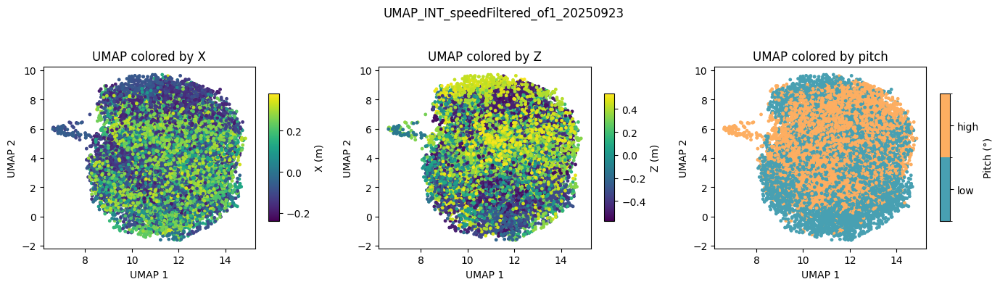

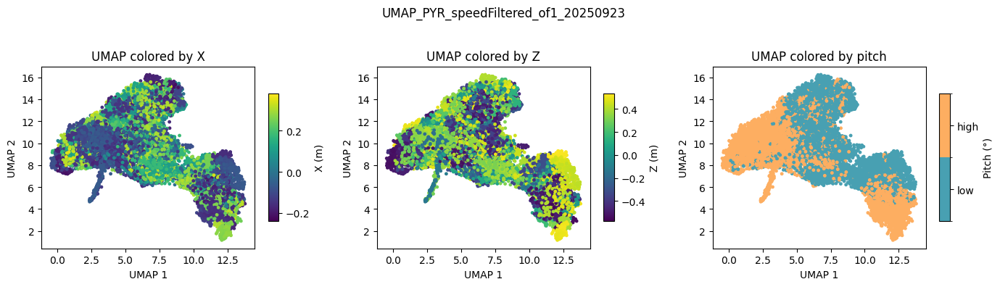

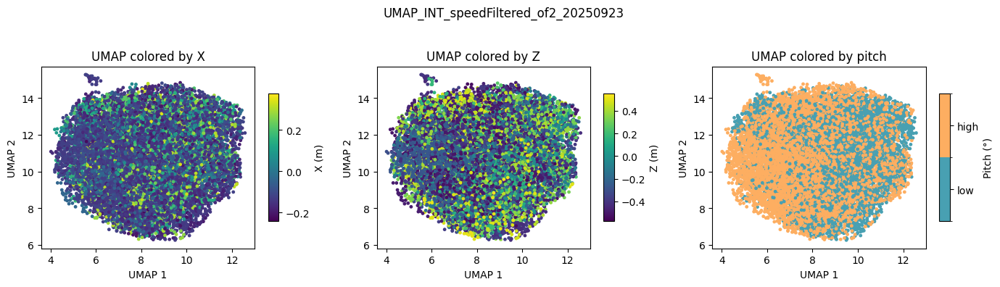

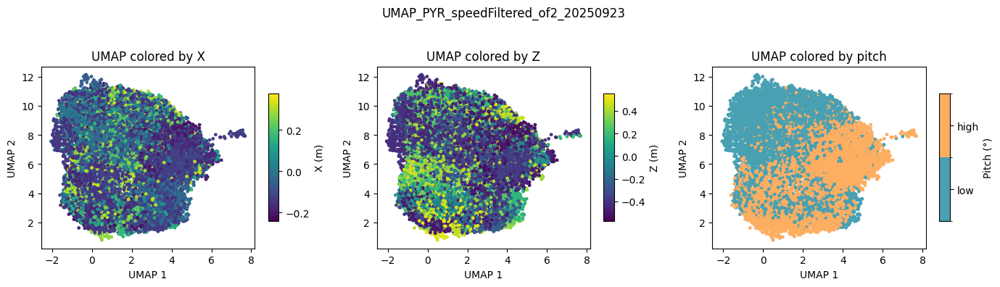

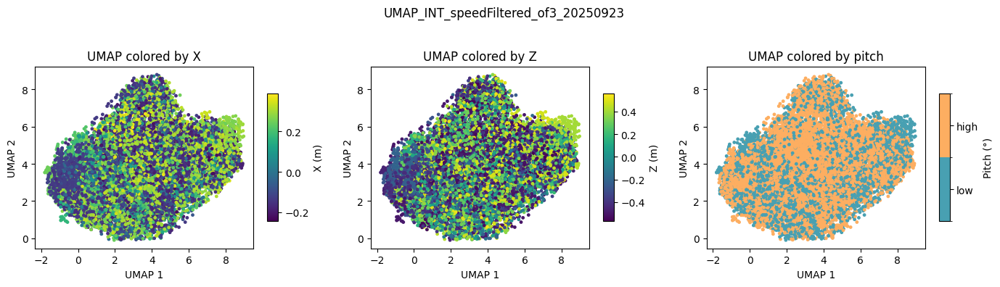

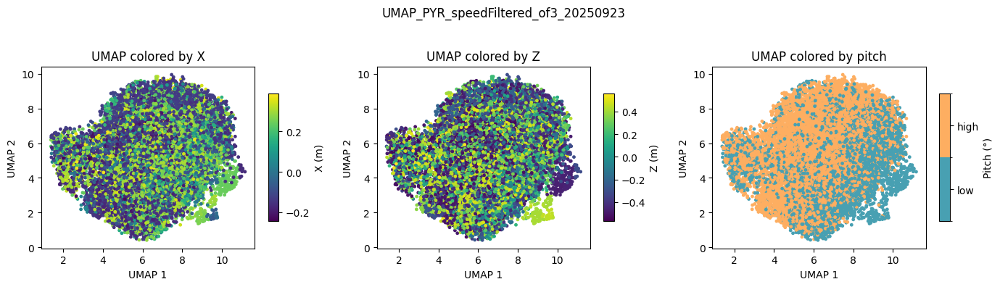

In [25]:
for of in of_keys:
    plot_umap(inter_emb[of], 'INT', of=of, date=date, pos_dict=pos_data_run[of], pitch_deg=pitch_run[of])
    plot_umap(pyr_emb[of], 'PYR', of=of, date=date, pos_dict=pos_data_run[of], pitch_deg=pitch_run[of])
    

In [26]:
def plot_umap_again(ur_emb, celltype, color_variavle, of_keys, date, arr_run, pa_path):
    fig, axs = plt.subplots(1, len(of_keys), figsize=(5 * len(of_keys), 4), constrained_layout=True)

    all_emb = []
    all_pitch = []

    for ax, of in zip(axs, of_keys):
        p = arr_run[of]
        emb = ur_emb[of]

        all_emb.append(emb)
        all_pitch.append(p)

    # Concatenate all data for consistent color scale
    all_emb = np.concatenate(all_emb)
    all_pitch = np.concatenate(all_pitch)

    vmin = np.min(all_pitch)
    vmax = np.max(all_pitch)

    for ax, of in zip(axs, of_keys):
        p = arr_run[of]
        emb = ur_emb[of]
        sc = ax.scatter(emb[:,0], emb[:,1], c=p, cmap='viridis', s=6, vmin=vmin, vmax=vmax)
        ax.set_title(f'{of}')
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')

    # Shared colorbar
    cbar = fig.colorbar(sc, ax=axs, shrink=0.8, aspect=25)
    cbar.set_label(f'{color_variavle}')

    filename = f'{celltype}_UMAP_colored_by_{color_variavle}_{date}'
    plt.suptitle(filename, fontsize=14)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

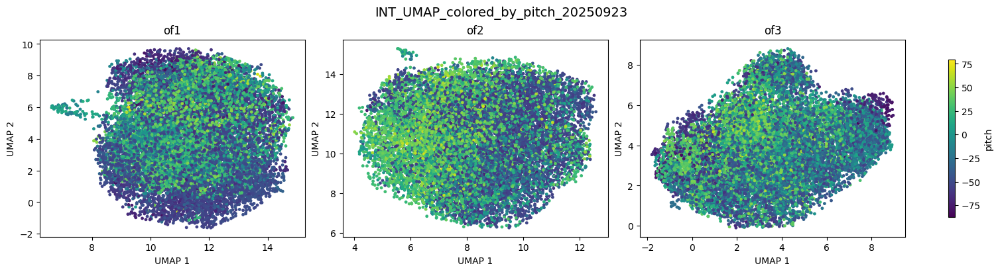

In [27]:
plot_umap_again(inter_emb, 'INT', color_variavle = 'pitch', of_keys=of_keys, date=date, arr_run=pitch_run, pa_path=pa_path)

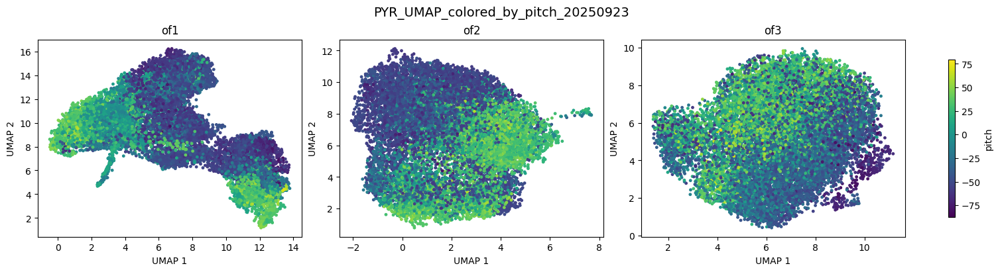

In [28]:
plot_umap_again(pyr_emb, 'PYR',  color_variavle = 'pitch', of_keys=of_keys, date=date, arr_run=pitch_run, pa_path=pa_path)

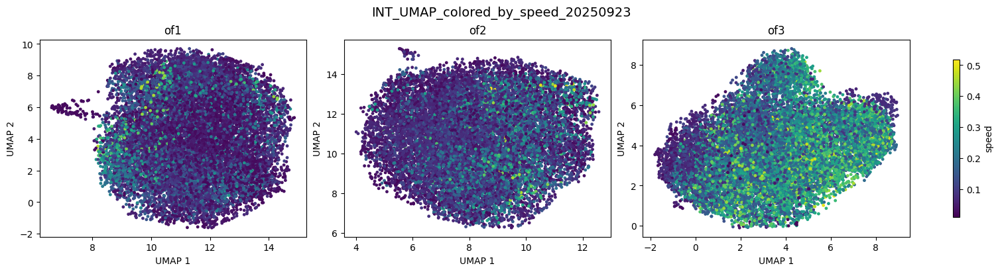

In [29]:
plot_umap_again(inter_emb, 'INT',  color_variavle = 'speed', of_keys=of_keys, date=date, arr_run=speeds_run, pa_path=pa_path)

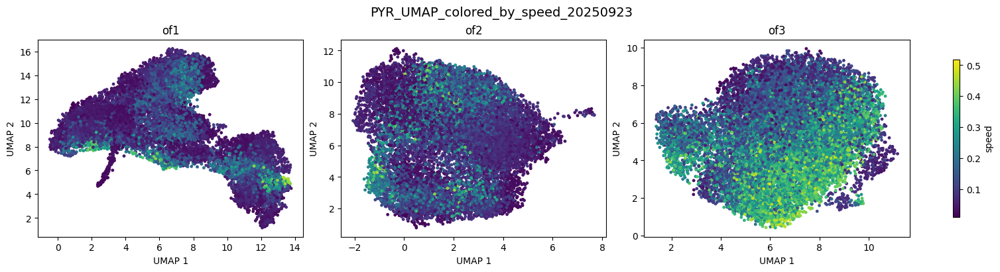

In [30]:
plot_umap_again(pyr_emb, 'PYR',  color_variavle = 'speed', of_keys=of_keys, date=date, arr_run=speeds_run, pa_path=pa_path)

In [31]:
def median_binned_umap(ur_emb, cell_type = "INT", nbins = 100, BORDERS = [-90, -30, 90], LABELS = ['low', 'high'], save=True):
    from scipy.stats import binned_statistic_2d
    fig, axs = plt.subplots(1, len(of_keys), figsize=(5 * len(of_keys), 4), constrained_layout=True)

    for ax, of in zip(axs, of_keys):
        p = pitch_run[of]
        p_binary = np.digitize(p, BORDERS) - 1  # 0 = low, 1 = high

        emb = ur_emb[of]

        # 2D binning
        stat, x_edges, y_edges, _ = binned_statistic_2d(
            emb[:, 0], emb[:, 1], p_binary, statistic='median', bins=nbins
        )

        im = ax.imshow(stat.T, origin='lower',
                    extent=(x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]),
                    aspect='auto', cmap='viridis')
        
        ax.set_title(f'{of}')
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')

    # One shared colorbar
    cbar = fig.colorbar(im, ax=axs, shrink=0.8, aspect=25)
    cbar.set_label('Median pitch (0 = low, 1 = high)')
    filename = f'{cell_type}_UMAP_binned_by_median_pitch_{date}'
    plt.suptitle(filename, fontsize=14)
    # plt.tight_layout()
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

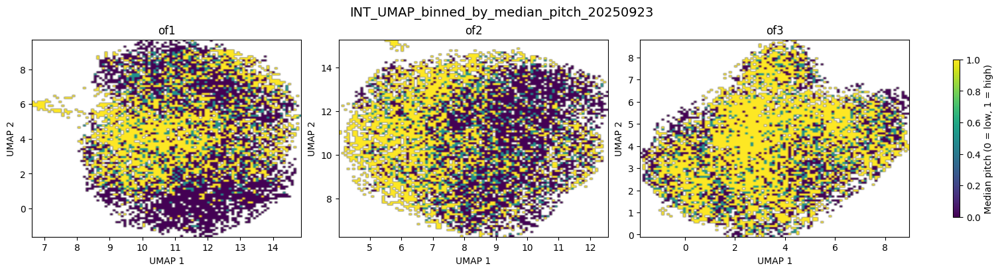

In [32]:
median_binned_umap(inter_emb, cell_type = "INT")

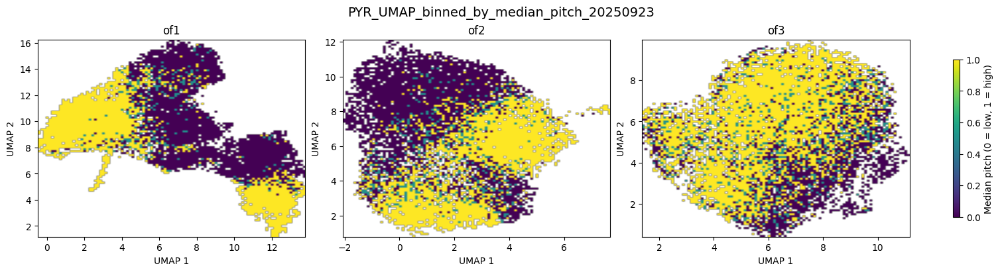

In [33]:
median_binned_umap(pyr_emb, cell_type = "PYR")

In [237]:
inter_emb['of1'].shape

(14189, 2)

### kde on behav states

In [34]:
from scipy.stats import gaussian_kde

In [36]:
def get_behavior_labels(pitch, y_pos, speed,
                        speed_thresh=0.02, # m
                        pitch_thresh=-30.0,
                        rearing_thresh=0.15):
    """
    Classify behavior into 3 categories:
      0 = low pitch walk
      1 = high pitch walk
      2 = rearing
    """
    labels = np.full_like(pitch, -1, dtype=int)

    # walking epochs
    walking = speed > speed_thresh
    still = speed <= speed_thresh

    # low pitch walk
    labels[(walking) & (pitch < pitch_thresh)] = 0

    # high pitch walk
    labels[(walking) & (pitch >= pitch_thresh)] = 1

    # rearing (using pitch or Y pos)
    labels[(still)&(y_pos >= rearing_thresh)] = 2

    return labels

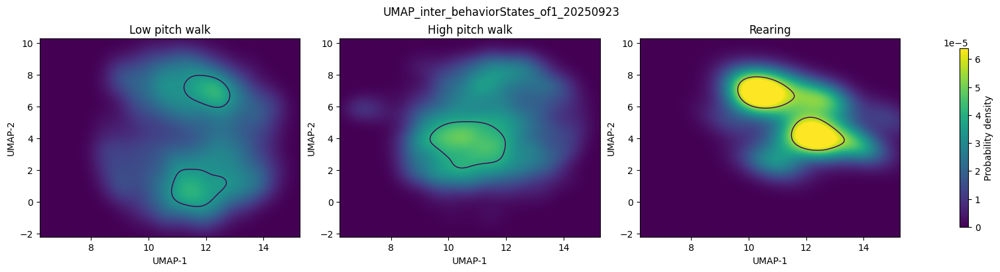

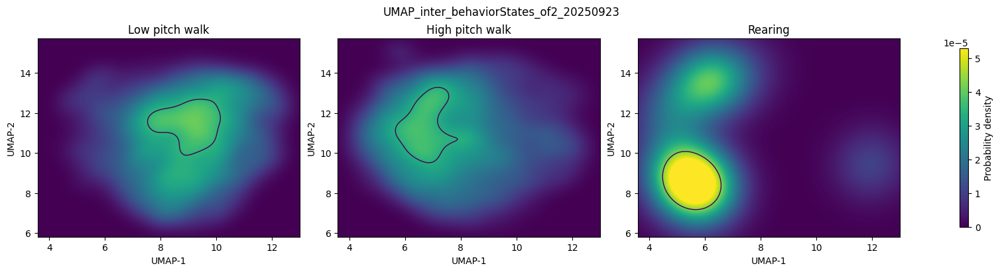

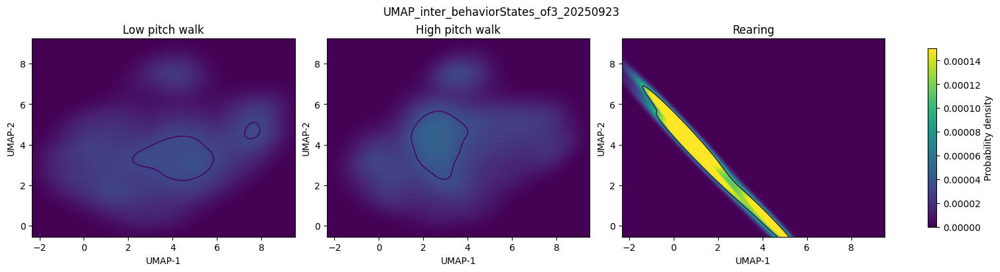

In [37]:
for of in of_keys:
    emb = inter_emb[of]  # (n_samples, 2)
    pitch = pitch_run[of]
    y_pos = pos_data_run[of]['Y']
    speed = speeds_run[of]

    # Get behavioral labels
    labels = get_behavior_labels(pitch, y_pos, speed)
    
    E = emb
    E_0 = E[labels == 0]  # low pitch walk
    E_1 = E[labels == 1]  # high pitch walk
    E_2 = E[labels == 2]  # rearing

    # Shared UMAP grid
    pad = 0.05
    xmin, ymin = E.min(0)
    xmax, ymax = E.max(0)
    xr = xmax - xmin; yr = ymax - ymin
    xmin -= pad * xr; xmax += pad * xr
    ymin -= pad * yr; ymax += pad * yr

    nx = ny = 300 # no idea how this is picked
    xs = np.linspace(xmin, xmax, nx)
    ys = np.linspace(ymin, ymax, ny)
    XX, YY = np.meshgrid(xs, ys)
    grid = np.vstack([XX.ravel(), YY.ravel()])

    # KDE helper
    def kde2d(points, bw_scale=1.0):
        if len(points) == 0:
            return np.zeros((ny, nx))  # handle empty class
        kde = gaussian_kde(points.T, bw_method='scott')
        kde.set_bandwidth(kde.factor * bw_scale)
        z = kde(grid).reshape(ny, nx)
        z /= z.sum()
        return z

    Z_0 = kde2d(E_0)
    Z_1 = kde2d(E_1)
    Z_2 = kde2d(E_2)

    # Shared vmax for all 3 plots
    vmax = np.percentile(np.r_[Z_0.ravel(), Z_1.ravel(), Z_2.ravel()], 99)

    # Plotting
    fig, axs = plt.subplots(1, 3, figsize=(15, 4), constrained_layout=True)
    titles = ['Low pitch walk', 'High pitch walk', 'Rearing']
    Z_list = [Z_0, Z_1, Z_2]

    for ax, Z, title in zip(axs, Z_list, titles):
        im = ax.imshow(Z, origin='lower', extent=[xmin, xmax, ymin, ymax],
                       vmin=0, vmax=vmax, aspect='auto')
        ax.set_title(title)
        ax.set_xlabel('UMAP-1')
        ax.set_ylabel('UMAP-2')
        levels = np.percentile(Z, [95])
        ax.contour(XX, YY, Z, levels=levels, linewidths=1)

    cbar = fig.colorbar(im, ax=axs, shrink=0.9)
    cbar.set_label('Probability density')

    filename = f'UMAP_inter_behaviorStates_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

## 3d UMAP

In [69]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap, BoundaryNorm

BORDERS = [-90, -30, 90]
LABELS  = ['low', 'high']
CMAP    = ListedColormap(['#48a0b2', '#fdae61'])
NORM    = BoundaryNorm(BORDERS, CMAP.N, clip=True)

def plot_umap_3d(emb, celltype, of, date, pos_dict, pitch_deg, pa_path):
    fig = plt.figure(figsize=(18, 5))

    # ---- UMAP by X ----
    ax1 = fig.add_subplot(1, 3, 1, projection='3d')
    sc1 = ax1.scatter(emb[:,0], emb[:,1], emb[:,2], c=pos_dict['X'], cmap='viridis', s=6)
    cbar1 = fig.colorbar(sc1, ax=ax1, shrink=0.7, aspect=12)
    cbar1.set_label('X (m)')
    ax1.set_title('UMAP colored by X')
    ax1.set_xlabel('UMAP 1'); ax1.set_ylabel('UMAP 2'); ax1.set_zlabel('UMAP 3')

    # ---- UMAP by Z ----
    ax2 = fig.add_subplot(1, 3, 2, projection='3d')
    sc2 = ax2.scatter(emb[:,0], emb[:,1], emb[:,2], c=pos_dict['Z'], cmap='viridis', s=6)
    cbar2 = fig.colorbar(sc2, ax=ax2, shrink=0.7, aspect=12)
    cbar2.set_label('Z (m)')
    ax2.set_title('UMAP colored by Z')
    ax2.set_xlabel('UMAP 1'); ax2.set_ylabel('UMAP 2'); ax2.set_zlabel('UMAP 3')

    # ---- UMAP by pitch (discrete bins) ----
    pitch = np.asarray(pitch_deg, float)
    valid = np.isfinite(pitch)

    ax3 = fig.add_subplot(1, 3, 3, projection='3d')
    sc3 = ax3.scatter(emb[valid,0], emb[valid,1], emb[valid,2], c=pitch[valid], cmap=CMAP, norm=NORM, s=6)
    tick_pos = [(BORDERS[i] + BORDERS[i+1]) / 2 for i in range(len(BORDERS)-1)]
    cbar3 = fig.colorbar(sc3, ax=ax3, ticks=tick_pos, shrink=0.7, aspect=12)
    cbar3.ax.set_yticklabels(LABELS)
    cbar3.set_label('Pitch (°)')
    ax3.set_title('UMAP colored by pitch')
    ax3.set_xlabel('UMAP 1'); ax3.set_ylabel('UMAP 2'); ax3.set_zlabel('UMAP 3')

    # ---- Save ----
    filename = f'UMAP3D_{celltype}_speedFiltered_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

In [68]:
pyr_emb3d = {}
inter_emb3d = {}

for of in of_keys:

    umap_kwargs = dict(n_components=3, n_neighbors=20, min_dist=0.5, metric='euclidean', random_state=42)

    cell_ids_all  = np.array(list(goodspiketimes.keys()))
    mask_pyr = np.isin(cell_ids_all, pyr)
    mask_inter = np.isin(cell_ids_all, inter)
    X_all = spike_matrix_run[of]
    X_pyr = X_all[:, mask_pyr]
    X_inter = X_all[:, mask_inter]

    pyr_reducer = umap.UMAP(**umap_kwargs)
    pyr_emb3d[of] = pyr_reducer.fit_transform(X_pyr)

    inter_reducer = umap.UMAP(**umap_kwargs)
    inter_emb3d[of] = inter_reducer.fit_transform(X_inter)

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/n

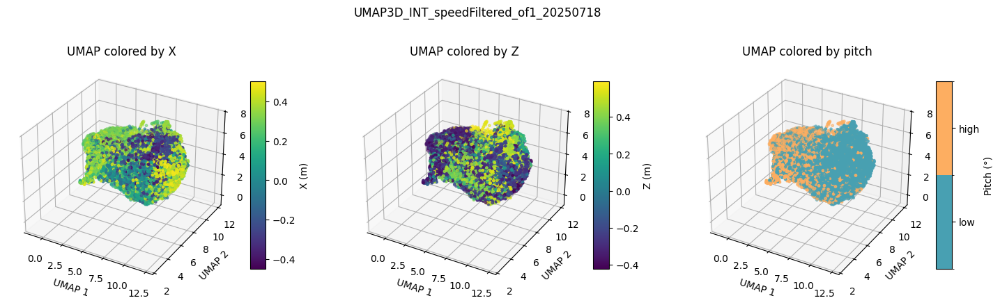

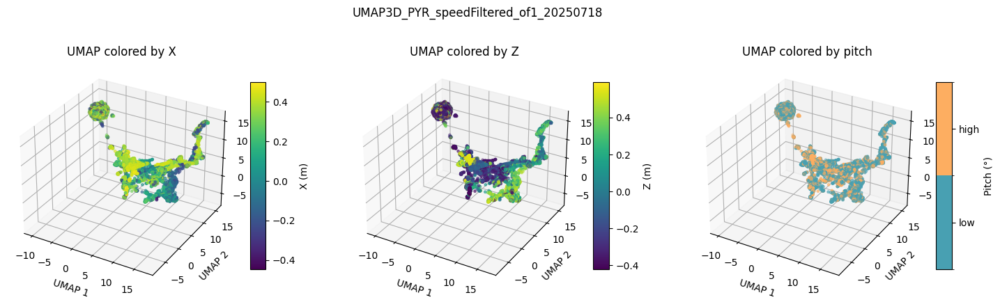

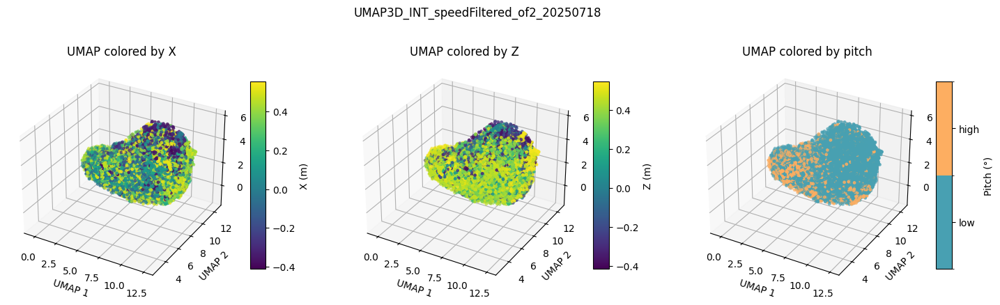

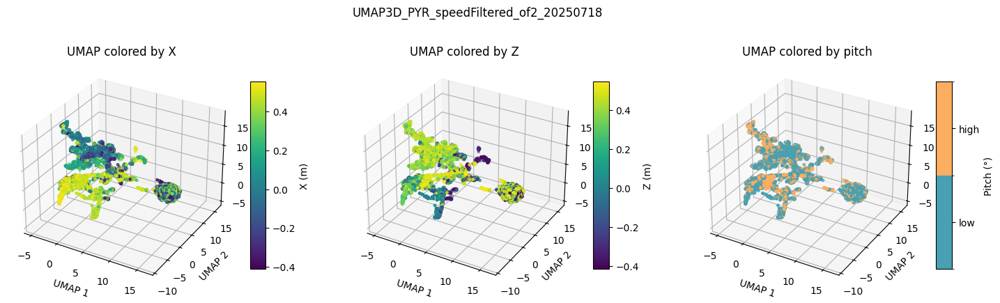

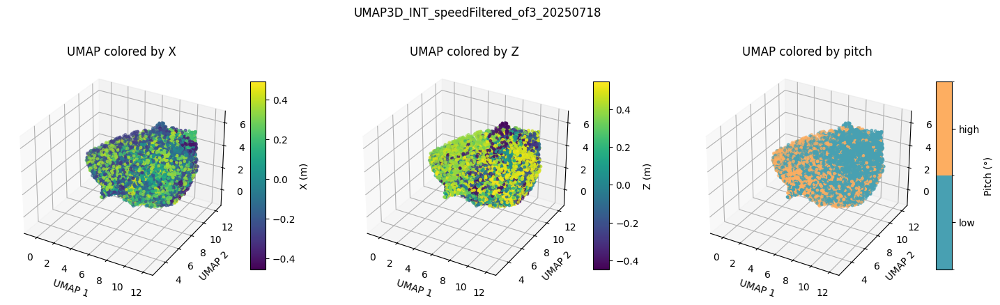

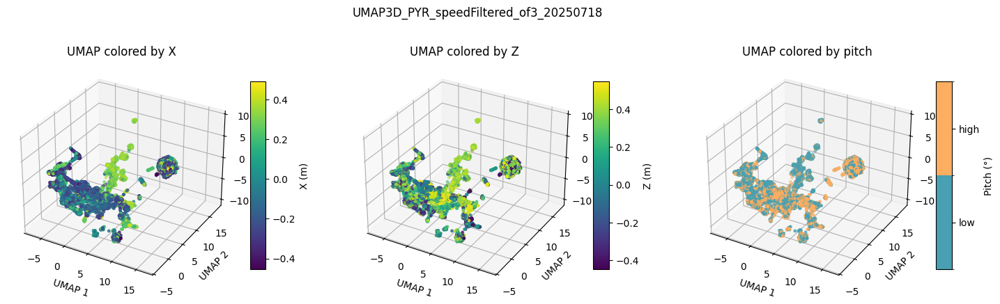

In [70]:
for of in of_keys:
    plot_umap_3d(inter_emb3d[of], 'INT', of=of, date=date, pos_dict=pos_data_run[of], pitch_deg=pitch_run[of], pa_path=pa_path)
    plot_umap_3d(pyr_emb3d[of], 'PYR', of=of, date=date, pos_dict=pos_data_run[of], pitch_deg=pitch_run[of], pa_path=pa_path)

In [71]:
from mpl_toolkits.mplot3d import Axes3D

def plot_umap_again_3d(ur_emb, celltype, color_variavle, of_keys, date, arr_run, pa_path,
                       cmap='viridis', point_size=6):
    """
    3D version of your 2D function:
    - ur_emb[of] : (n_samples, 3) UMAP embeddings per environment
    - arr_run[of]: array-like color values per sample (e.g., pitch, X, Z, etc.)
    """
    fig = plt.figure(figsize=(5 * len(of_keys), 5), constrained_layout=True)

    # --- gather for global color scale ---
    all_vals = []
    for of in of_keys:
        vals = np.asarray(arr_run[of], float)
        vals = vals[np.isfinite(vals)]
        if vals.size:
            all_vals.append(vals)
    if not all_vals:
        raise ValueError("No finite color values found across of_keys.")
    all_vals = np.concatenate(all_vals)
    vmin, vmax = np.nanmin(all_vals), np.nanmax(all_vals)

    # --- subplots ---
    last_sc = None
    for i, of in enumerate(of_keys, start=1):
        emb = np.asarray(ur_emb[of])
        cval = np.asarray(arr_run[of], float)

        # mask NaNs in colors (and make sure emb has same length)
        valid = np.isfinite(cval)
        emb = emb[valid]
        cval = cval[valid]

        ax = fig.add_subplot(1, len(of_keys), i, projection='3d')
        sc = ax.scatter(
            emb[:, 0], emb[:, 1], emb[:, 2],
            c=cval, cmap=cmap, s=point_size, vmin=vmin, vmax=vmax
        )
        last_sc = sc  # keep a handle for shared colorbar

        ax.set_title(f'{of}')
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')
        ax.set_zlabel('UMAP 3')

    # --- shared colorbar ---
    cbar = fig.colorbar(last_sc, ax=[fig.axes[k] for k in range(len(of_keys))], shrink=0.8, aspect=25)
    cbar.set_label(f'{color_variavle}')

    filename = f'{celltype}_UMAP3D_colored_by_{color_variavle}_{date}'
    plt.suptitle(filename, fontsize=14)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

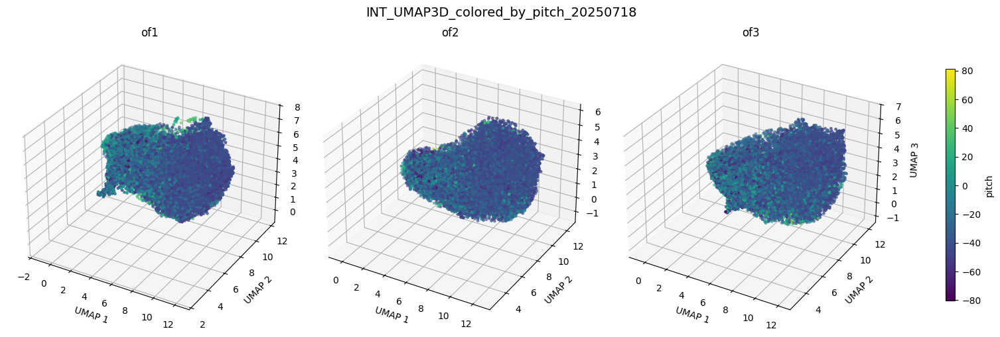

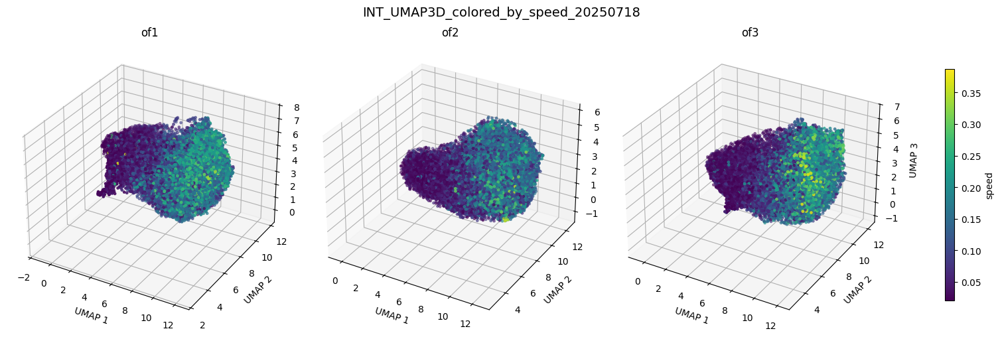

In [ ]:
plot_umap_again_3d(inter_emb3d, 'INT', color_variavle = 'pitch', of_keys=of_keys, date=date, arr_run=pitch_run, pa_path=pa_path)
plot_umap_again_3d(inter_emb3d, 'INT', color_variavle = 'speed', of_keys=of_keys, date=date, arr_run=speeds_run, pa_path=pa_path)

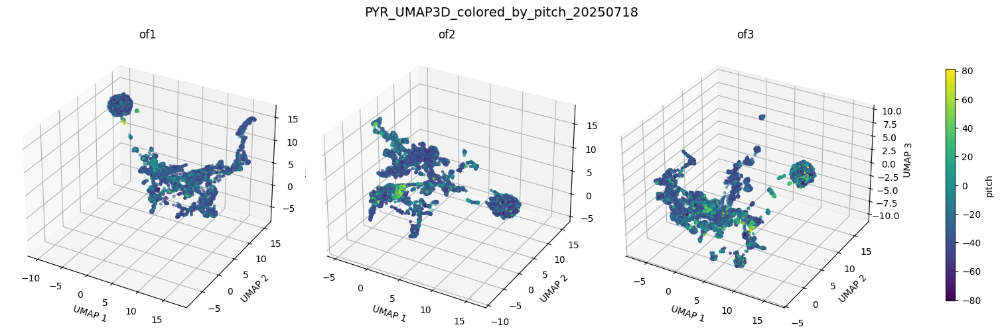

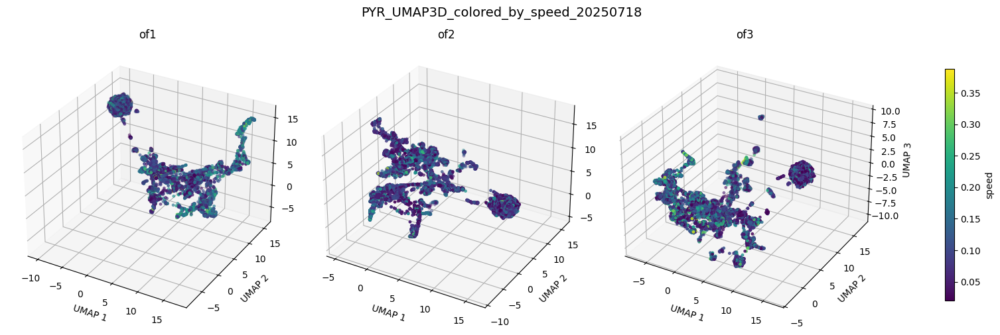

In [81]:
plot_umap_again_3d(pyr_emb3d, 'PYR', color_variavle = 'pitch', of_keys=of_keys, date=date, arr_run=pitch_run, pa_path=pa_path)
plot_umap_again_3d(pyr_emb3d, 'PYR', color_variavle = 'speed', of_keys=of_keys, date=date, arr_run=speeds_run, pa_path=pa_path)

## Pitch split

In [83]:
BORDERS = [-90, -30, 90]  # low < -30, high ≥ -30

pitch_umaps = {}

for of in of_keys:
    pyr_umap = {}
    inter_umap = {}

    umap_kwargs = dict(n_neighbors=20, min_dist=0.5, metric='euclidean', random_state=42)

    X_all = spike_matrix_run[of]  # shape: (n_bins, n_cells)
    cell_ids_all = np.array(list(goodspiketimes.keys()))

    # Cell type masks
    mask_pyr = np.isin(cell_ids_all, pyr)
    mask_inter = np.isin(cell_ids_all, inter)

    X_pyr = X_all[:, mask_pyr]
    X_inter = X_all[:, mask_inter]

    # Binary pitch label
    pitch = pitch_run[of]
    pitch_binary = np.digitize(pitch, BORDERS) - 1  # 0 = low, 1 = high

    # Boolean masks
    mask_low  = pitch_binary == 0
    mask_high = pitch_binary == 1

    # Subsets
    X_pyr_low   = X_pyr[mask_low]
    X_pyr_high  = X_pyr[mask_high]
    X_int_low   = X_inter[mask_low]
    X_int_high  = X_inter[mask_high]

    # Apply UMAP
    reducer = umap.UMAP(**umap_kwargs)
    pyr_umap['low']   = reducer.fit_transform(X_pyr_low)
    pyr_umap['high']  = reducer.fit_transform(X_pyr_high)
    inter_umap['low'] = reducer.fit_transform(X_int_low)
    inter_umap['high'] = reducer.fit_transform(X_int_high)

    # Store both
    pitch_umaps[of] = {
        'pyr': pyr_umap,
        'inter': inter_umap
    }

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [102]:
def plot_pitch_umaps(pitch_umaps, of_keys):
    # Define titles
    cell_types = ['PYR', 'INT']
    pitch_states = ['LP', 'HP']

    # Color palette for OFs
    cmap = plt.cm.get_cmap("Set1", len(of_keys))  # distinct colors
    colors = {of: cmap(i) for i, of in enumerate(of_keys)}

    # 2 rows (pyr/inter), 2 cols per OF → total cols = 2 * len(of_keys)
    n_of = len(of_keys)
    fig, axs = plt.subplots(2, 2*n_of, figsize=(4*n_of, 4), constrained_layout=True)

    for i, of in enumerate(of_keys):

        col = 2 * i
        color = colors[of]
    
        # Retrieve embeddings
        emb_pyr_low  = pitch_umaps[of]['pyr']['low']
        emb_pyr_high = pitch_umaps[of]['pyr']['high']
        emb_int_low  = pitch_umaps[of]['inter']['low']
        emb_int_high = pitch_umaps[of]['inter']['high']

        # Column offset for this OF
        col = 2 * i

        # Top row: pyramidal
        axs[0, col].scatter(emb_pyr_low[:, 0], emb_pyr_low[:, 1], s=3, alpha=0.4,color=color)
        axs[0, col].set_title(f'{of}\n{cell_types[0]} - {pitch_states[0]}')

        axs[0, col+1].scatter(emb_pyr_high[:, 0], emb_pyr_high[:, 1], s=3, alpha=0.4,color=color)
        axs[0, col+1].set_title(f'{cell_types[0]} - {pitch_states[1]}')

        # Bottom row: interneurons
        axs[1, col].scatter(emb_int_low[:, 0], emb_int_low[:, 1], s=3, alpha=0.4,color=color)
        axs[1, col].set_title(f'{cell_types[1]} - {pitch_states[0]}')

        axs[1, col+1].scatter(emb_int_high[:, 0], emb_int_high[:, 1], s=3, alpha=0.4,color=color)
        axs[1, col+1].set_title(f'{cell_types[1]} - {pitch_states[1]}')

    # Labels for all
    for ax in axs.ravel():
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')

    plt.suptitle('UMAP projections across environments', fontsize=14)
    plt.show()

/tmp/ipykernel_18976/1572861573.py:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("Set1", len(of_keys))  # distinct colors


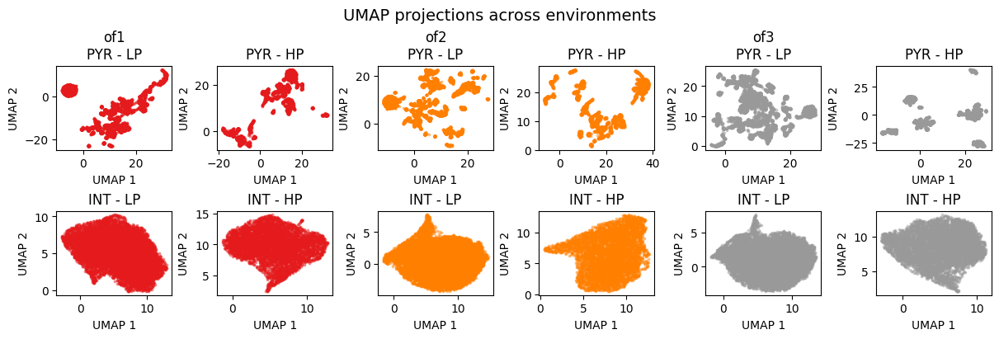

In [103]:
plot_pitch_umaps(pitch_umaps, of_keys)

In [137]:
def plot_pitch_umap_colored_by_position(of, pitch_binary, pos_dict, color_axis='Y'):
    import matplotlib.pyplot as plt
    from matplotlib import cm
    import numpy as np

    # Setup smaller figure
    fig, axs = plt.subplots(2, 2, figsize=(7, 7), constrained_layout=True)
    umaps = pitch_umaps[of]
    data_color = np.asarray(pos_dict[color_axis])
    mask_low  = pitch_binary == 0
    mask_high = pitch_binary == 1

    # Extract coloring variable
    col_low  = data_color[mask_low]
    col_high = data_color[mask_high]

    # Get UMAPs
    emb_pyr_low  = umaps['pyr']['low']
    emb_pyr_high = umaps['pyr']['high']
    emb_int_low  = umaps['inter']['low']
    emb_int_high = umaps['inter']['high']

    # Colormap + shared limits
    cmap = cm.viridis
    # vmin = np.nanpercentile(data_color, 1)
    # vmax = np.nanpercentile(data_color, 99)
    shrink=0.6
    aspect = 25

    # Plot each panel with its own colorbar
    sc1 = axs[0, 0].scatter(emb_pyr_low[:, 0], emb_pyr_low[:, 1], 
                            c=col_low, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[0, 0].set_title('Pyramidal - Low pitch')
    cbar1 = fig.colorbar(sc1, ax=axs[0, 0], shrink=shrink, aspect=aspect)
    cbar1.set_label(f'{color_axis} [m]', fontsize=8)

    sc2 = axs[0, 1].scatter(emb_pyr_high[:, 0], emb_pyr_high[:, 1], 
                            c=col_high, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[0, 1].set_title('Pyramidal - High pitch')
    cbar2 = fig.colorbar(sc2, ax=axs[0, 1], shrink=shrink, aspect=aspect)
    cbar2.set_label(f'{color_axis} [m]', fontsize=8)

    sc3 = axs[1, 0].scatter(emb_int_low[:, 0], emb_int_low[:, 1], 
                            c=col_low, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[1, 0].set_title('Interneuron - Low pitch')
    cbar3 = fig.colorbar(sc3, ax=axs[1, 0], shrink=shrink, aspect=aspect)
    cbar3.set_label(f'{color_axis} [m]', fontsize=8)

    sc4 = axs[1, 1].scatter(emb_int_high[:, 0], emb_int_high[:, 1], 
                            c=col_high, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[1, 1].set_title('Interneuron - High pitch')
    cbar4 = fig.colorbar(sc4, ax=axs[1, 1], shrink=shrink, aspect=aspect)
    cbar4.set_label(f'{color_axis} [m]', fontsize=8)

    # Common axis settings
    for ax in axs.ravel():
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')
        # ax.set_aspect('equal')
        ax.set_box_aspect(1)
    filename = f'INT_LPHP_UMAPs_by_Y_{of}_{date}'
    plt.suptitle(filename)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')

    plt.show()

In [141]:
from matplotlib import cm

def plot_pitch_umap_colored_by_position(of, pitch_binary, color_variavle, arr_run):
    '''
    color_variavle = 'speed', 'Y', whatever u wanna see as label
    arr_run - any arr with variable to color with (pos_data_run[of]['Y'], speeds_run[of])
    '''

    # Setup smaller figure
    fig, axs = plt.subplots(2, 2, figsize=(7, 6), constrained_layout=True)
    umaps = pitch_umaps[of]
    data_color = arr_run 
    mask_low  = pitch_binary == 0
    mask_high = pitch_binary == 1

    # Extract coloring variable
    col_low  = data_color[mask_low]
    col_high = data_color[mask_high]

    # Get UMAPs
    emb_pyr_low  = umaps['pyr']['low']
    emb_pyr_high = umaps['pyr']['high']
    emb_int_low  = umaps['inter']['low']
    emb_int_high = umaps['inter']['high']

    # Colormap + shared limits
    cmap = cm.viridis
    # vmin = np.nanpercentile(data_color, 1)
    # vmax = np.nanpercentile(data_color, 99)
    shrink=0.6
    aspect = 25

    # Plot each panel with its own colorbar
    sc1 = axs[0, 0].scatter(emb_pyr_low[:, 0], emb_pyr_low[:, 1], 
                            c=col_low, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[0, 0].set_title('PYR_LP')
    cbar1 = fig.colorbar(sc1, ax=axs[0, 0], shrink=shrink, aspect=aspect)
    cbar1.set_label(f'{color_variavle}', fontsize=8)

    sc2 = axs[0, 1].scatter(emb_pyr_high[:, 0], emb_pyr_high[:, 1], 
                            c=col_high, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[0, 1].set_title('PYR_HP')
    cbar2 = fig.colorbar(sc2, ax=axs[0, 1], shrink=shrink, aspect=aspect)
    cbar2.set_label(f'{color_variavle}', fontsize=8)

    sc3 = axs[1, 0].scatter(emb_int_low[:, 0], emb_int_low[:, 1], 
                            c=col_low, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[1, 0].set_title('INT_LP')
    cbar3 = fig.colorbar(sc3, ax=axs[1, 0], shrink=shrink, aspect=aspect)
    cbar3.set_label(f'{color_variavle}', fontsize=8)

    sc4 = axs[1, 1].scatter(emb_int_high[:, 0], emb_int_high[:, 1], 
                            c=col_high, cmap=cmap, s=5)#, vmin=vmin, vmax=vmax)
    axs[1, 1].set_title('INT_HP')
    cbar4 = fig.colorbar(sc4, ax=axs[1, 1], shrink=shrink, aspect=aspect)
    cbar4.set_label(f'{color_variavle}', fontsize=8)

    # Common axis settings
    for ax in axs.ravel():
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')
        # ax.set_aspect('equal')
        ax.set_box_aspect(1)
    filename = f'INT_LPHP_UMAPs_by_{color_variavle}_{of}_{date}'
    plt.suptitle(filename)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')

    plt.show()

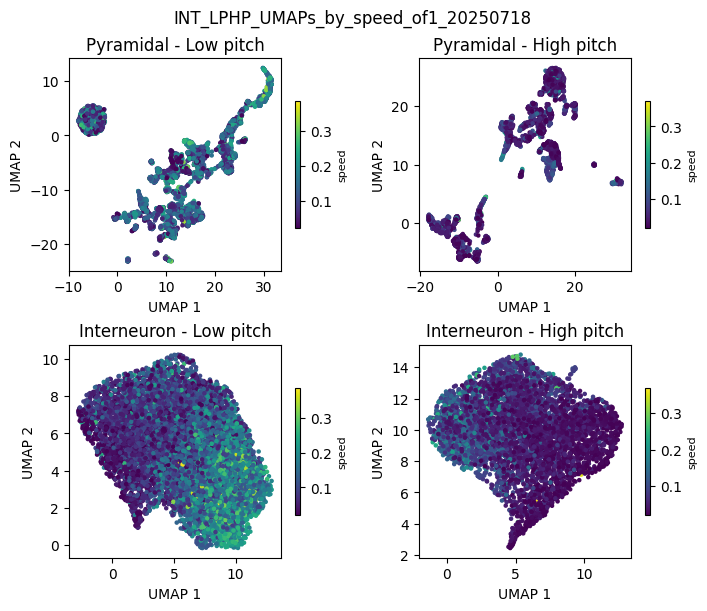

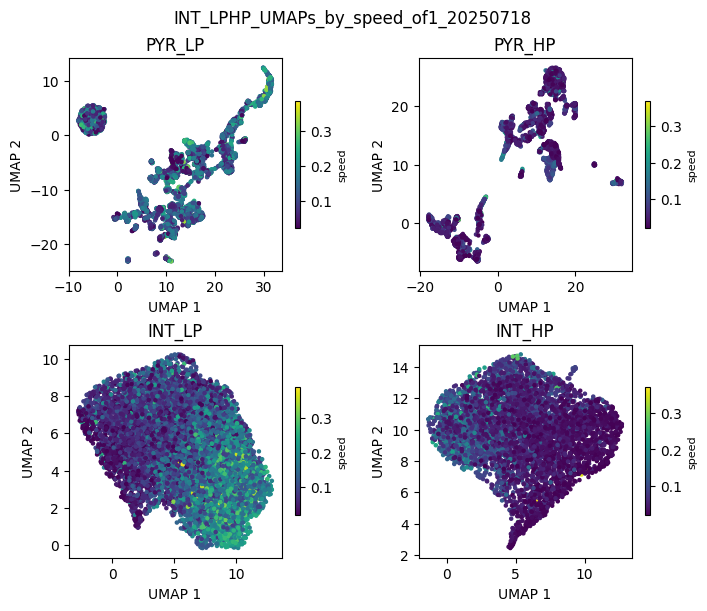

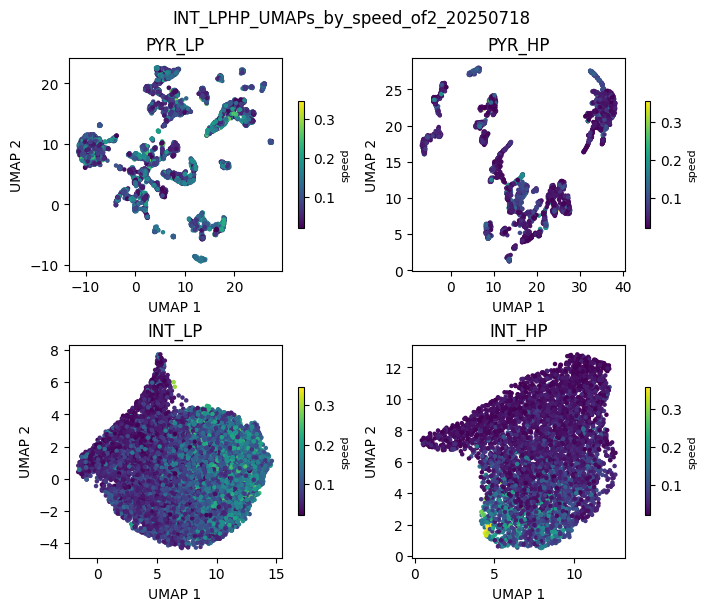

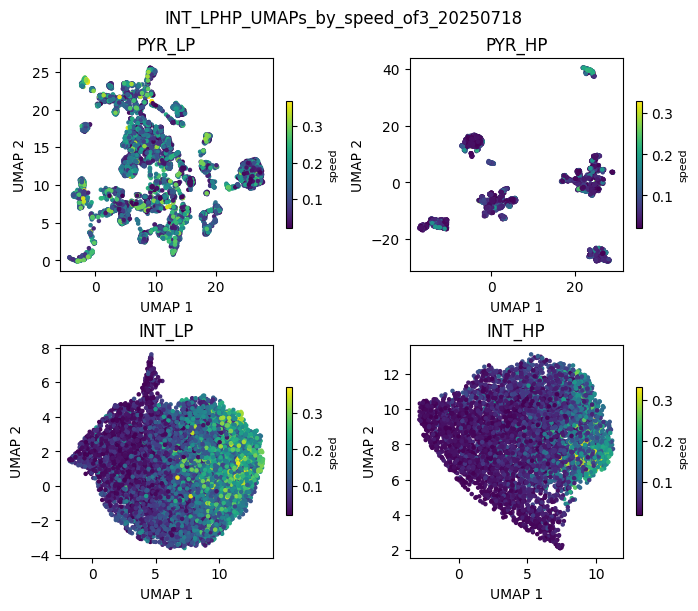

In [142]:
for of in of_keys:
    pitch = pitch_run[of]
    pitch_binary = np.digitize(pitch, [-90, -30, 90]) - 1
    plot_pitch_umap_colored_by_position(of, pitch_binary, color_variavle = 'speed', arr_run=speeds_run[of])

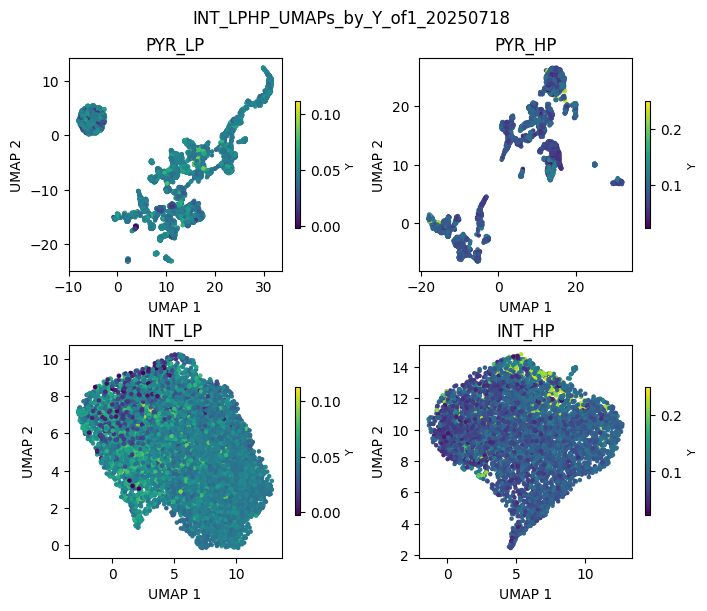

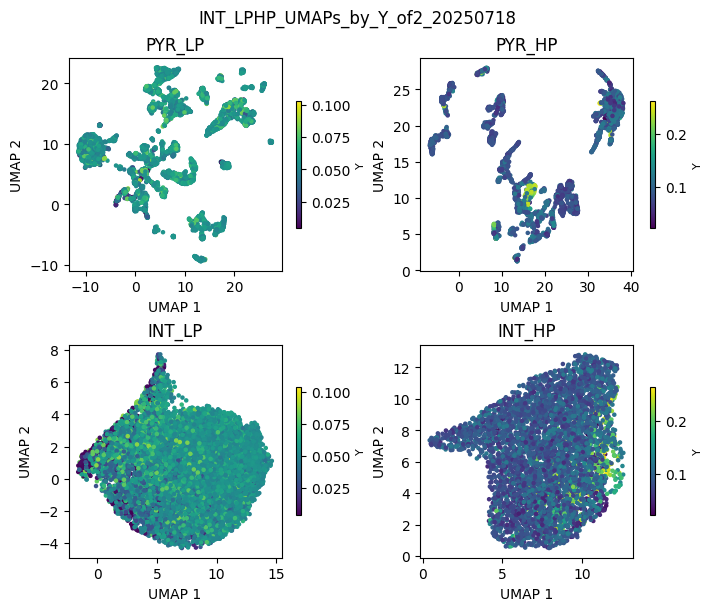

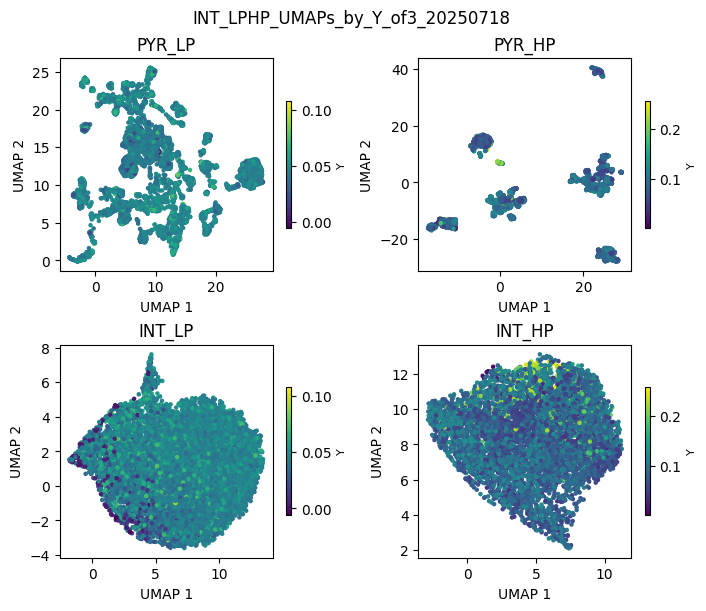

In [143]:
for of in of_keys:
    pitch = pitch_run[of]
    pitch_binary = np.digitize(pitch, [-90, -30, 90]) - 1
    plot_pitch_umap_colored_by_position(of, pitch_binary, color_variavle = 'Y', arr_run=pos_data_run[of]['Y'])

In [135]:
from scipy.stats import binned_statistic_2d
from matplotlib import cm

def plot_inter_umap_binned_by_Y(of, pitch_binary, pos_dict, nbins=50):

    umaps = pitch_umaps[of]['inter']
    Y = np.asarray(pos_dict['Y'])
    mask_low  = pitch_binary == 0
    mask_high = pitch_binary == 1

    Y_low  = Y[mask_low]
    Y_high = Y[mask_high]

    emb_low  = umaps['low']
    emb_high = umaps['high']

    # Bin UMAP space and compute median Y in each bin
    stat_low, x_edges_low, y_edges_low, _ = binned_statistic_2d(
        emb_low[:, 0], emb_low[:, 1], Y_low, statistic='median', bins=nbins
    )

    stat_high, x_edges_high, y_edges_high, _ = binned_statistic_2d(
        emb_high[:, 0], emb_high[:, 1], Y_high, statistic='median', bins=nbins
    )

    # Plotting
    fig, axs = plt.subplots(1, 2, figsize=(8, 3.5), constrained_layout=True)
    cmap = cm.viridis
    shrink=0.6
    aspect = 25

    im1 = axs[0].imshow(stat_low.T, origin='lower',
                        extent=(x_edges_low[0], x_edges_low[-1], y_edges_low[0], y_edges_low[-1]),
                        aspect='equal', cmap=cmap)
    axs[0].set_title('INT LP')
    cbar1 = fig.colorbar(im1, ax=axs[0], shrink=shrink, aspect=aspect)
    cbar1.set_label('Median Y [m]')

    im2 = axs[1].imshow(stat_high.T, origin='lower',
                        extent=(x_edges_high[0], x_edges_high[-1], y_edges_high[0], y_edges_high[-1]),
                        aspect='equal', cmap=cmap)
    axs[1].set_title('IMT HP')
    cbar2 = fig.colorbar(im2, ax=axs[1], shrink=shrink,aspect=aspect)
    cbar2.set_label('Median Y [m]')

    for ax in axs.ravel():
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')
        ax.set_box_aspect(1)

    # # Shared colorbar (combined vmin/vmax across both)
    # vmin = np.nanmin([stat_low, stat_high])
    # vmax = np.nanmax([stat_low, stat_high])
    # im1.set_clim(vmin, vmax)
    # im2.set_clim(vmin, vmax)
    # cbar = fig.colorbar(im2, ax=axs, shrink=0.7, aspect=25)
    # cbar.set_label('Median Y position [m]')
    filename = f'INT_LPHP_UMAPs_by_median_Y_{of}_{date}'
    plt.suptitle(filename)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

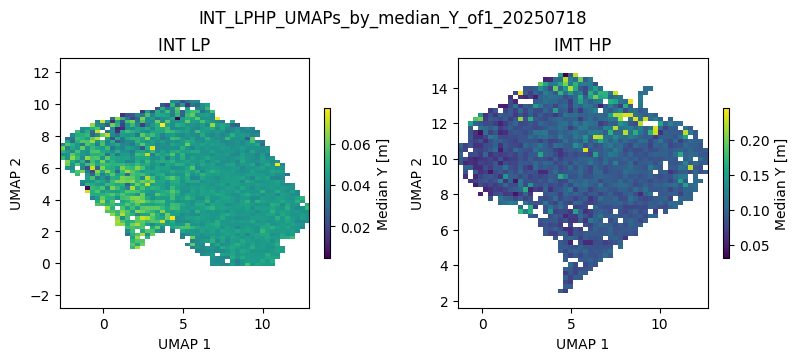

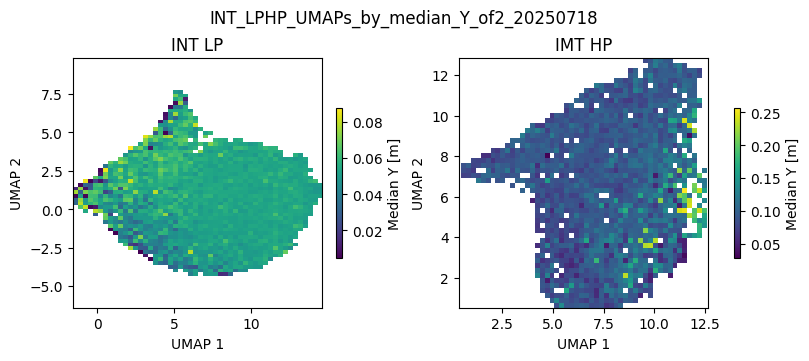

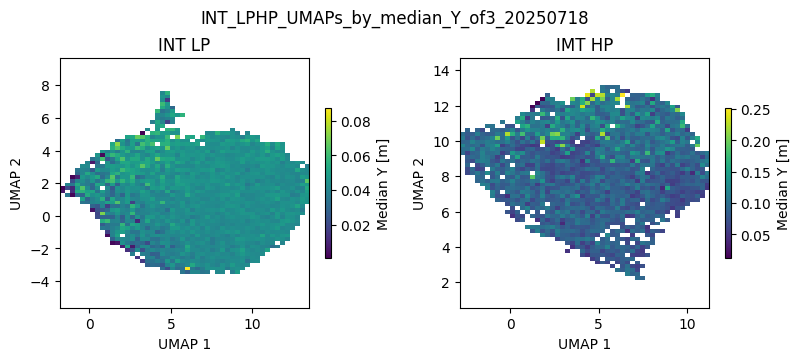

In [136]:
for of in of_keys:
    pitch = pitch_run[of]
    pitch_binary = np.digitize(pitch, [-90, -30, 90]) - 1
    plot_inter_umap_binned_by_Y(of, pitch_binary, pos_data_run[of])

In [239]:
from scipy.stats import gaussian_kde

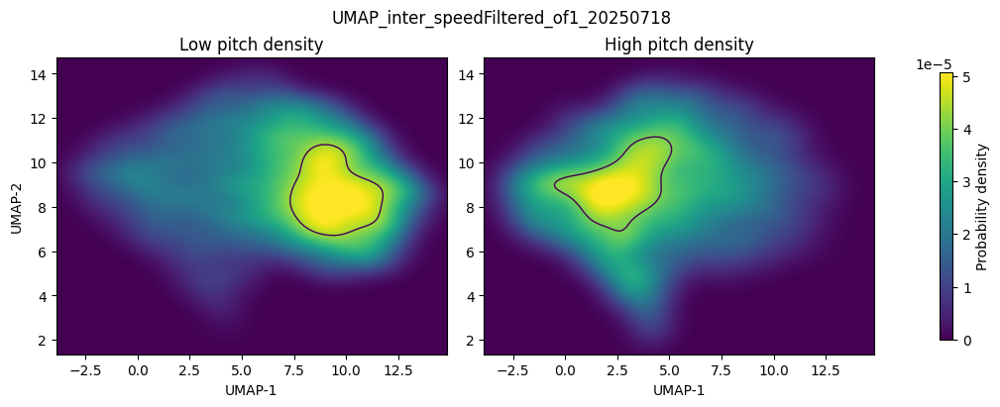

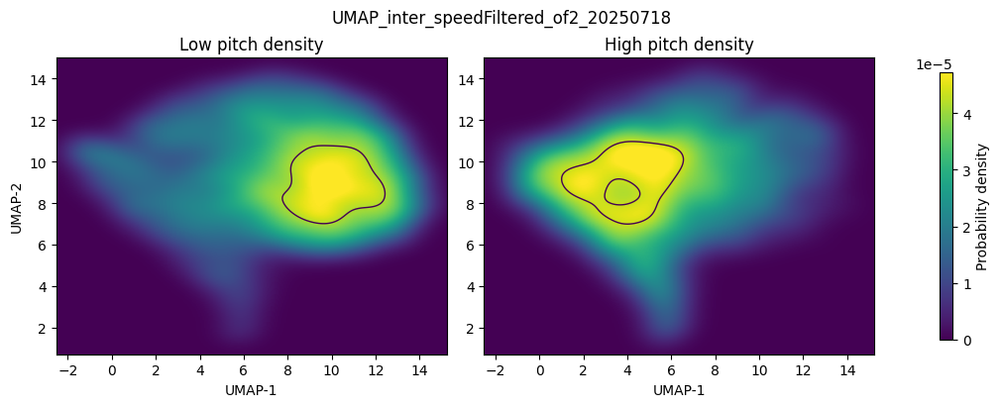

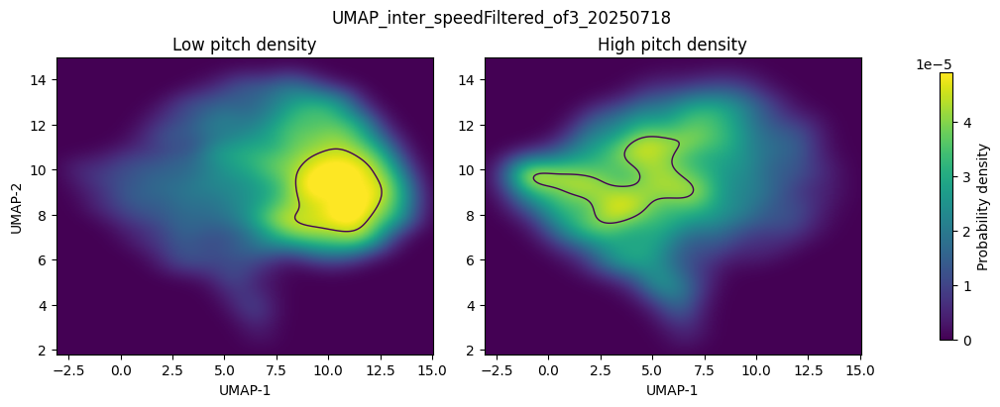

In [48]:
for of in of_keys:

    emb = inter_emb[of] # (n_samples, 2)
    pitch = pitch_run[of] # (n_samples,)
    boundary = -30 # scalar threshold separating low vs high pitch (from your valley method)

    # 1) Split data
    mask_high = pitch >= boundary
    mask_low  = ~mask_high

    E = emb
    E_hi = E[mask_high]
    E_lo = E[mask_low]

    # 2) Build a common grid (very important for visual comparability)
    pad = 0.05  # 5% padding
    xmin, ymin = E.min(0)
    xmax, ymax = E.max(0)
    xr = xmax - xmin; yr = ymax - ymin
    xmin -= pad*xr; xmax += pad*xr
    ymin -= pad*yr; ymax += pad*yr

    nx = ny = 300
    xs = np.linspace(xmin, xmax, nx)
    ys = np.linspace(ymin, ymax, ny)
    XX, YY = np.meshgrid(xs, ys)
    grid = np.vstack([XX.ravel(), YY.ravel()])

    # 3) KDEs (use Scott bandwidth; scale if you want sharper ↔ smoother)
    def kde2d(points, bw_scale=1.0):
        kde = gaussian_kde(points.T, bw_method='scott')
        kde.set_bandwidth(kde.factor * bw_scale)
        z = kde(grid).reshape(ny, nx)
        z /= z.sum()  # make each map integrate to 1 (probability density)
        return z

    Z_hi = kde2d(E_hi, bw_scale=1.0)
    Z_lo = kde2d(E_lo, bw_scale=1.0)

    # 4) Choose a shared color scale (use robust max to avoid outliers)
    vmax = np.percentile(np.r_[Z_hi.ravel(), Z_lo.ravel()], 99)

    # 5) Plot side-by-side
    fig, axs = plt.subplots(1, 2, figsize=(10,4), constrained_layout=True)
    im0 = axs[0].imshow(Z_lo, origin='lower', extent=[xmin,xmax,ymin,ymax],
                        vmin=0, vmax=vmax, aspect='auto')
    axs[0].set_title('Low pitch density')
    axs[0].set_xlabel('UMAP-1'); axs[0].set_ylabel('UMAP-2')

    im1 = axs[1].imshow(Z_hi, origin='lower', extent=[xmin,xmax,ymin,ymax],
                        vmin=0, vmax=vmax, aspect='auto')
    axs[1].set_title('High pitch density')
    axs[1].set_xlabel('UMAP-1')

    # optional contours at fixed probability mass
    for ax, Z in zip(axs, [Z_lo, Z_hi]):
        levels = np.percentile(Z, [95]) #90, 97, 99])
        ax.contour(XX, YY, Z, levels=levels, linewidths=1)

    cbar = fig.colorbar(im1, ax=axs, shrink=0.9)
    cbar.set_label('Probability density')
    filename = f'UMAP_inter_speedFiltered_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

# # 6) (Bonus) Log-density ratio map: highlights broccoli regions enriched in high vs low
# eps = 1e-12
# L = np.log((Z_hi + eps)/(Z_lo + eps))

# plt.figure(figsize=(5,4))
# plt.imshow(L, origin='lower', extent=[xmin,xmax,ymin,ymax], aspect='auto')
# plt.contour(XX, YY, L, levels=[0], colors='k', linewidths=1)  # boundary where hi = lo
# plt.title('log density ratio  (high / low)')
# plt.xlabel('UMAP-1'); plt.ylabel('UMAP-2'); plt.colorbar(label='log ratio')
# plt.show()

## Rearing

In [ ]:
# spike_matrix
# pos_data_resampled
# pitch_resampled


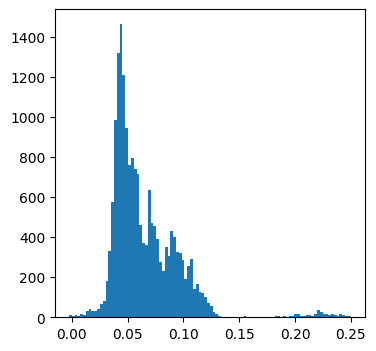

In [61]:
plt.figure(figsize=(4,4)); plt.hist(pos_data_resampled['of1']['Y'], bins=100); plt.show()

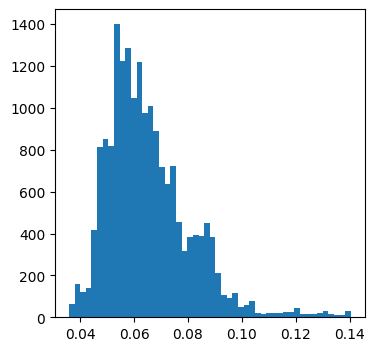

In [81]:
sigma_time = 0.5                                # seconds
sigma_frames = max(1, int(round(sigma_time * 120)))
s_y = gaussian_filter1d(pos_data_resampled['of1']['Y'], sigma=sigma_frames)

plt.figure(figsize=(4,4)); plt.hist(s_y, bins=50); plt.show()

In [82]:
# bins in meters: [0–0.10) = other; [0.10–0.25] = rearing
BORDERS = [0.0, 0.15, 0.25]
LABELS  = ['other', 'rearing']   # len == number of bins (len(BORDERS)-1)
CMAP    = ListedColormap(['#000080', '#FFD700'])
NORM    = BoundaryNorm(BORDERS, CMAP.N, clip=True)

def get_umap_v3(X, celltype, umap_kwargs, of, date, pos_dict, output_dir=None, fs=120):
    """
    X:           (n_samples, n_features)
    pos_dict:    dict with key 'Y' -> array-like of length n_samples (meters)
    """
    # 1) Fit UMAP
    reducer = umap.UMAP(**umap_kwargs)
    emb = reducer.fit_transform(X)

    # 2) Prepare output path
    output_dir = Path(output_dir) if output_dir is not None else Path(".")
    output_dir.mkdir(parents=True, exist_ok=True)

    # 3) Smooth Y (height)
    y = np.asarray(pos_dict, float)           # <— was the main bug
    # sigma_time = 0.5                                # seconds
    # sigma_frames = max(1, int(round(sigma_time * fs)))
    # y = gaussian_filter1d(y, sigma=sigma_frames)
    valid = np.isfinite(y)

    # 4) Plot: categorical coloring via BoundaryNorm
    fig, ax = plt.subplots(1, 1, figsize=(5, 4))
    sc = ax.scatter(emb[valid, 0], emb[valid, 1],
                    c=y[valid], cmap=CMAP, norm=NORM, s=6)

    ax.set_title('UMAP colored by Y')
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')

    # 5) Discrete colorbar with category labels at bin midpoints
    tick_pos = [0.5*(BORDERS[i] + BORDERS[i+1]) for i in range(len(BORDERS)-1)]
    cbar = fig.colorbar(sc, ax=ax, ticks=tick_pos, shrink=0.7, aspect=12)  # <— ticks, not label
    cbar.ax.set_yticklabels(LABELS)
    cbar.set_label('Height class (m)')

    # 6) Save
    filename = f'UMAP_{celltype}_rearing_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    fig.savefig(output_dir / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

    return emb

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


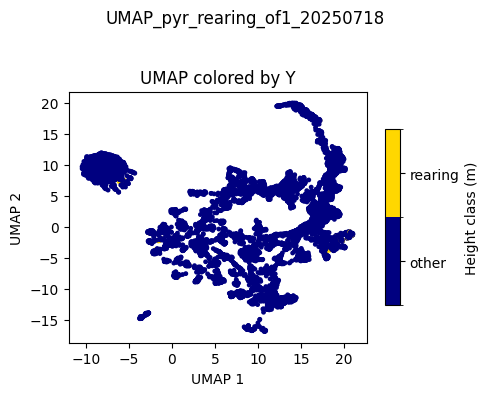

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


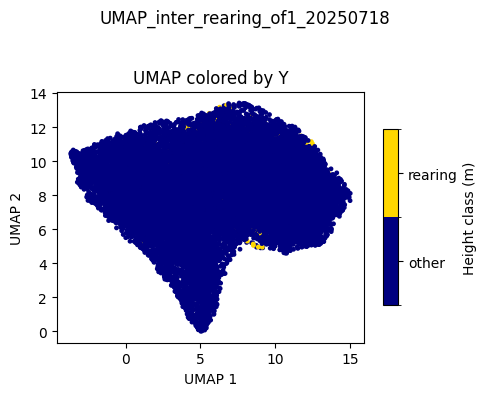

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


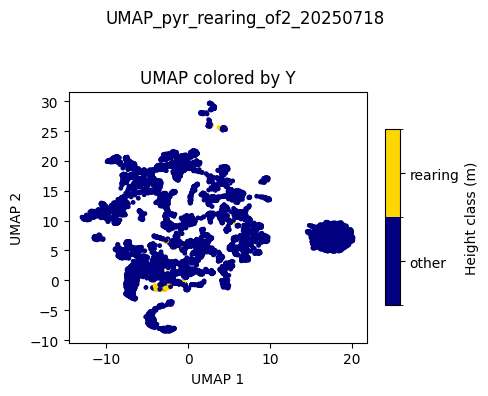

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


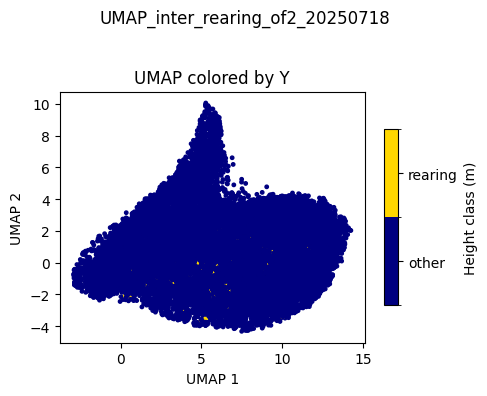

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


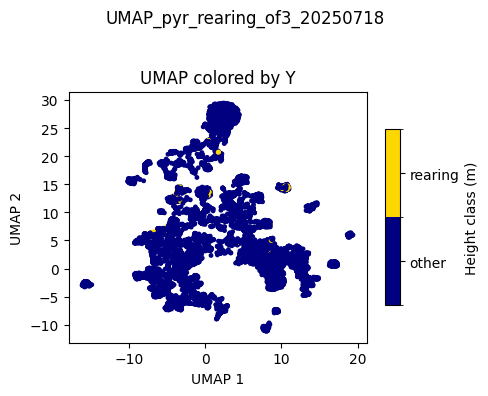

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


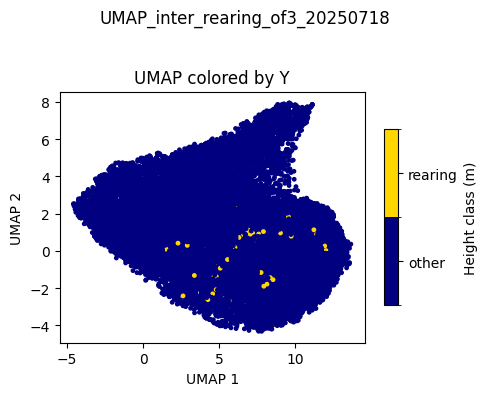

In [83]:
pyr_r_emb = {}
inter_r_emb = {}

for of in of_keys:
    # umap_kwargs = dict(n_neighbors=15, min_dist=0.1, metric="euclidean", random_state=42)
    umap_kwargs = dict(n_neighbors=20, min_dist=0.5, metric='euclidean', random_state=42)

    cell_ids_all  = np.array(list(goodspiketimes.keys()))
    mask_pyr = np.isin(cell_ids_all, pyr)
    mask_inter = np.isin(cell_ids_all, inter)
    X_all = spike_matrix[of].T
    X_pyr = X_all[:, mask_pyr]
    X_inter = X_all[:, mask_inter]
    # --------------------------------------------------------

    pyr_r_emb[of] = get_umap_v3(X_pyr, 'pyr', umap_kwargs=umap_kwargs, of=of, date=date, pos_dict=pos_data_resampled[of]['Y'])
    inter_r_emb[of] = get_umap_v3(X_inter, 'inter',umap_kwargs=umap_kwargs, of=of, date=date, pos_dict=pos_data_resampled[of]['Y'])

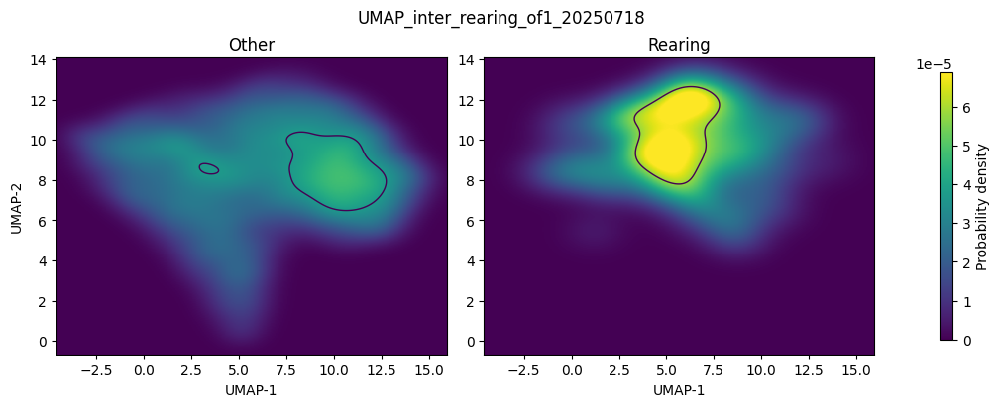

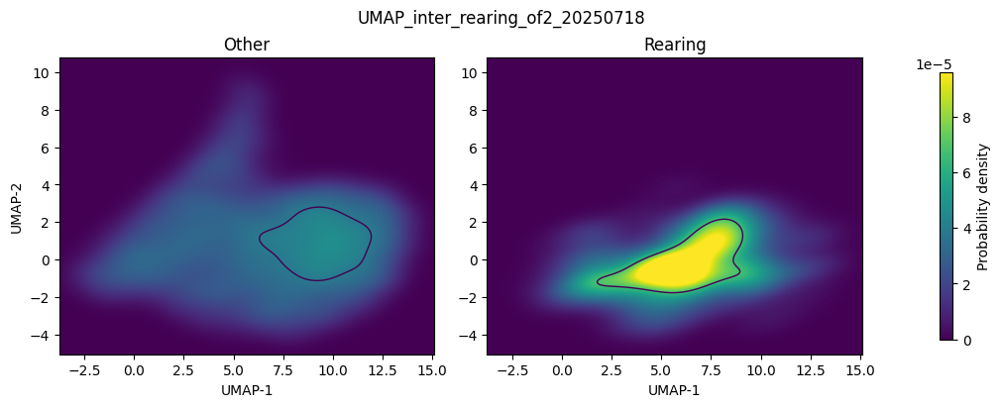

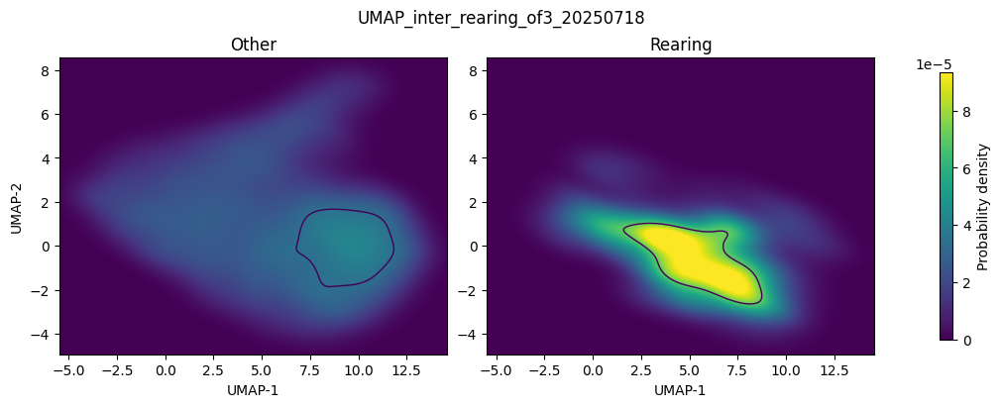

In [84]:
for of in of_keys:

    emb = inter_r_emb[of] # (n_samples, 2)
    height = pos_data_resampled[of]['Y'] # (n_samples,)
    # sigma_time = 0.5  # 500 ms smoothing
    # sigma_frames = int(sigma_time * 120)
    # height = gaussian_filter1d(height, sigma=sigma_frames)
    boundary = 0.15 # scalar threshold separating states

    # 1) Split data
    mask_high = height >= boundary
    mask_low  = ~mask_high

    E = emb
    E_hi = E[mask_high]
    E_lo = E[mask_low]

    # 2) Build a common grid (very important for visual comparability)
    pad = 0.05  # 5% padding
    xmin, ymin = E.min(0)
    xmax, ymax = E.max(0)
    xr = xmax - xmin; yr = ymax - ymin
    xmin -= pad*xr; xmax += pad*xr
    ymin -= pad*yr; ymax += pad*yr

    nx = ny = 300
    xs = np.linspace(xmin, xmax, nx)
    ys = np.linspace(ymin, ymax, ny)
    XX, YY = np.meshgrid(xs, ys)
    grid = np.vstack([XX.ravel(), YY.ravel()])

    # 3) KDEs (use Scott bandwidth; scale if you want sharper ↔ smoother)
    def kde2d(points, bw_scale=1.0):
        kde = gaussian_kde(points.T, bw_method='scott')
        kde.set_bandwidth(kde.factor * bw_scale)
        z = kde(grid).reshape(ny, nx)
        z /= z.sum()  # make each map integrate to 1 (probability density)
        return z

    Z_hi = kde2d(E_hi, bw_scale=1.0)
    Z_lo = kde2d(E_lo, bw_scale=1.0)

    # 4) Choose a shared color scale (use robust max to avoid outliers)
    vmax = np.percentile(np.r_[Z_hi.ravel(), Z_lo.ravel()], 99)

    # 5) Plot side-by-side
    fig, axs = plt.subplots(1, 2, figsize=(10,4), constrained_layout=True)
    im0 = axs[0].imshow(Z_lo, origin='lower', extent=[xmin,xmax,ymin,ymax],
                        vmin=0, vmax=vmax, aspect='auto')
    axs[0].set_title('Other')
    axs[0].set_xlabel('UMAP-1'); axs[0].set_ylabel('UMAP-2')

    im1 = axs[1].imshow(Z_hi, origin='lower', extent=[xmin,xmax,ymin,ymax],
                        vmin=0, vmax=vmax, aspect='auto')
    axs[1].set_title('Rearing')
    axs[1].set_xlabel('UMAP-1')

    # optional contours at fixed probability mass
    for ax, Z in zip(axs, [Z_lo, Z_hi]):
        levels = np.percentile(Z, [95]) #90, 97, 99])
        ax.contour(XX, YY, Z, levels=levels, linewidths=1)

    cbar = fig.colorbar(im1, ax=axs, shrink=0.9)
    cbar.set_label('Probability density')
    filename = f'UMAP_inter_rearing_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

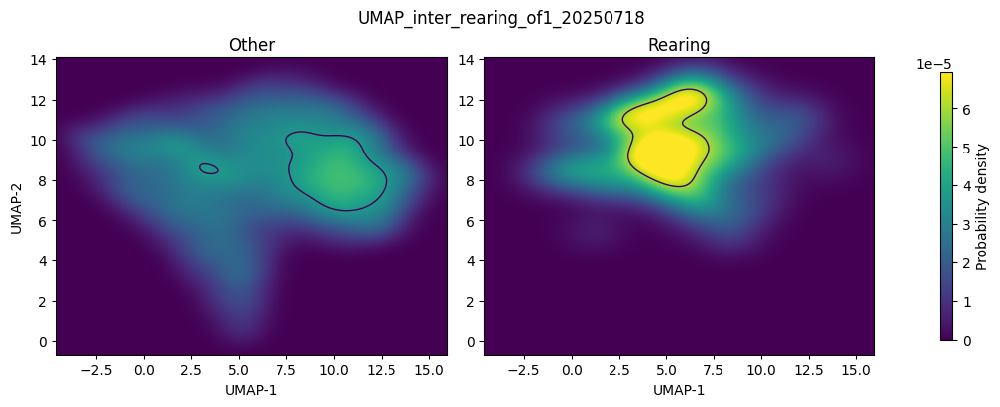

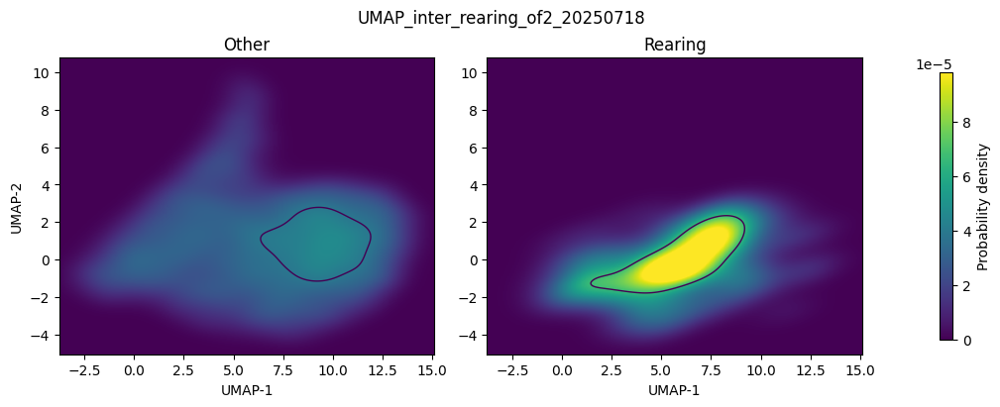

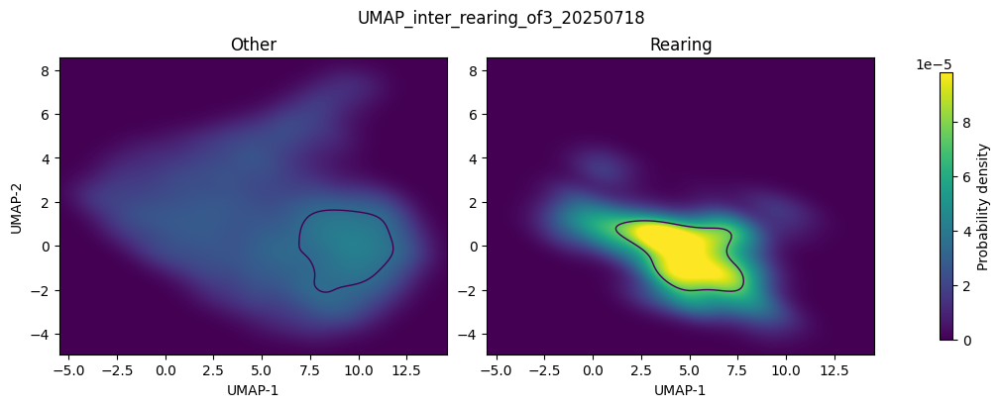

In [86]:
for of in of_keys:

    emb = inter_r_emb[of] # (n_samples, 2)
    height = pos_data_resampled[of]['Y'] # (n_samples,)
    # sigma_time = 0.5  # 500 ms smoothing
    # sigma_frames = int(sigma_time * 120)
    # height = gaussian_filter1d(height, sigma=sigma_frames)
    boundary = 0.20 # scalar threshold separating states

    # 1) Split data
    mask_high = height >= boundary
    mask_low  = ~mask_high

    E = emb
    E_hi = E[mask_high]
    E_lo = E[mask_low]

    # 2) Build a common grid (very important for visual comparability)
    pad = 0.05  # 5% padding
    xmin, ymin = E.min(0)
    xmax, ymax = E.max(0)
    xr = xmax - xmin; yr = ymax - ymin
    xmin -= pad*xr; xmax += pad*xr
    ymin -= pad*yr; ymax += pad*yr

    nx = ny = 300
    xs = np.linspace(xmin, xmax, nx)
    ys = np.linspace(ymin, ymax, ny)
    XX, YY = np.meshgrid(xs, ys)
    grid = np.vstack([XX.ravel(), YY.ravel()])

    # 3) KDEs (use Scott bandwidth; scale if you want sharper ↔ smoother)
    def kde2d(points, bw_scale=1.0):
        kde = gaussian_kde(points.T, bw_method='scott')
        kde.set_bandwidth(kde.factor * bw_scale)
        z = kde(grid).reshape(ny, nx)
        z /= z.sum()  # make each map integrate to 1 (probability density)
        return z

    Z_hi = kde2d(E_hi, bw_scale=1.0)
    Z_lo = kde2d(E_lo, bw_scale=1.0)

    # 4) Choose a shared color scale (use robust max to avoid outliers)
    vmax = np.percentile(np.r_[Z_hi.ravel(), Z_lo.ravel()], 99)

    # 5) Plot side-by-side
    fig, axs = plt.subplots(1, 2, figsize=(10,4), constrained_layout=True)
    im0 = axs[0].imshow(Z_lo, origin='lower', extent=[xmin,xmax,ymin,ymax],
                        vmin=0, vmax=vmax, aspect='auto')
    axs[0].set_title('Other')
    axs[0].set_xlabel('UMAP-1'); axs[0].set_ylabel('UMAP-2')

    im1 = axs[1].imshow(Z_hi, origin='lower', extent=[xmin,xmax,ymin,ymax],
                        vmin=0, vmax=vmax, aspect='auto')
    axs[1].set_title('Rearing')
    axs[1].set_xlabel('UMAP-1')

    # optional contours at fixed probability mass
    for ax, Z in zip(axs, [Z_lo, Z_hi]):
        levels = np.percentile(Z, [95]) #90, 97, 99])
        ax.contour(XX, YY, Z, levels=levels, linewidths=1)

    cbar = fig.colorbar(im1, ax=axs, shrink=0.9)
    cbar.set_label('Probability density')
    filename = f'UMAP_inter_rearing_{of}_{date}'
    fig.suptitle(filename, fontsize=12)
    plt.savefig(pa_path / f"{filename}.png", dpi=300, bbox_inches='tight')
    plt.show()

### Chopping

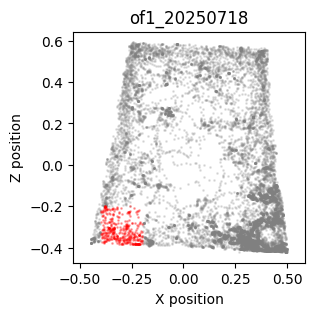

In [ ]:
plt.figure(figsize=(3,3))
plt.scatter(x[~mask_xz], z[~mask_xz], color='grey', s=1, alpha=0.2)
plt.scatter(x[mask_xz], z[mask_xz], color='red', s=1, alpha=0.3)
plt.xlabel("X position")
plt.ylabel("Z position")
plt.title(f'{of}_{date}')
plt.axis('equal')
plt.show()

In [180]:
def chopchop(of = 'of1', x_borders  = [-0.4, -0.2], z_borders = [-0.4,-0.2], umap_kwargs=dict(n_neighbors=15, min_dist=0.1, metric="euclidean", random_state=42)):

    # chopping
    x = pos_data_run[of]['X']
    z = pos_data_run[of]['Z']

    mask_x = (x >= x_borders[0]) & (x <= x_borders[1])
    mask_z = (z >= z_borders[0]) & (z <= z_borders[1])

    mask_xz = mask_x & mask_z

    chopped_pos = {}
    chopped_pos['X'] = pos_data_run[of]['X'][mask_xz]
    chopped_pos['Z'] = pos_data_run[of]['Z'][mask_xz]

    X_all = spike_matrix_run[of]
    X_pyr =  X_all[np.ix_(mask_xz, mask_pyr)]
    X_inter =  X_all[np.ix_(mask_xz, mask_inter)]

    plt.figure(figsize=(3,3))
    plt.scatter(x[~mask_xz], z[~mask_xz], color='grey', s=1, alpha=0.2)
    plt.scatter(x[mask_xz], z[mask_xz], color='red', s=1, alpha=0.3)
    plt.xlabel("X position")
    plt.ylabel("Z position")
    plt.title(f'{of}_{date}')
    plt.axis('equal')
    plt.show()

    get_umap(X_pyr, umap_kwargs=umap_kwargs, of=of, date=date, pos_dict=chopped_pos)
    get_umap(X_inter, umap_kwargs=umap_kwargs, of=of, date=date, pos_dict=chopped_pos)



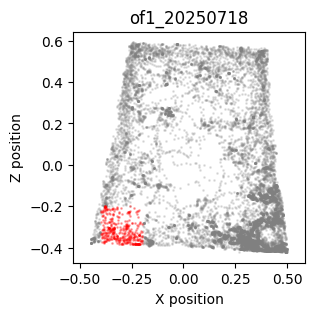

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


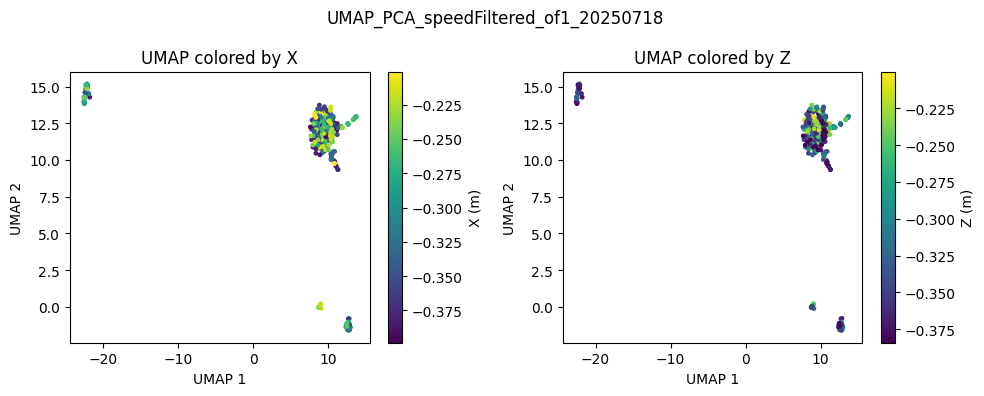

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


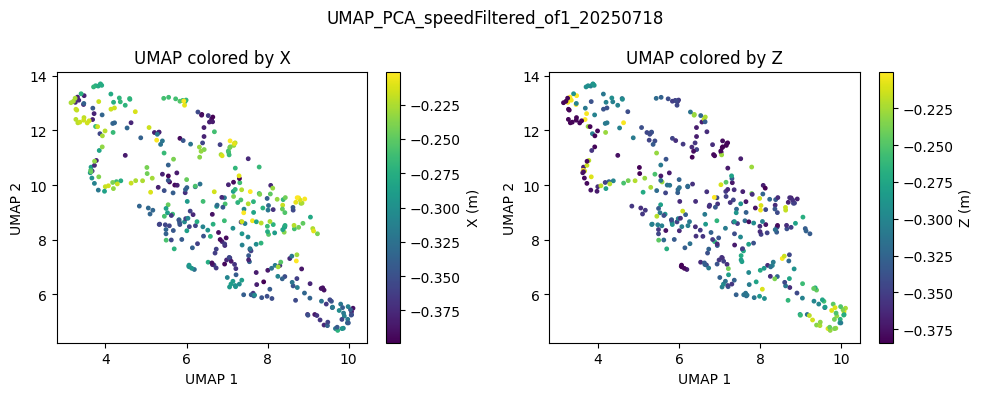

In [181]:
chopchop(of = 'of1', x_borders  = [-0.4, -0.2], z_borders = [-0.4,-0.2])

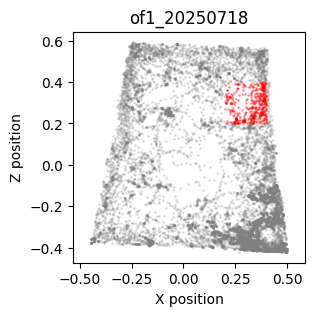

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


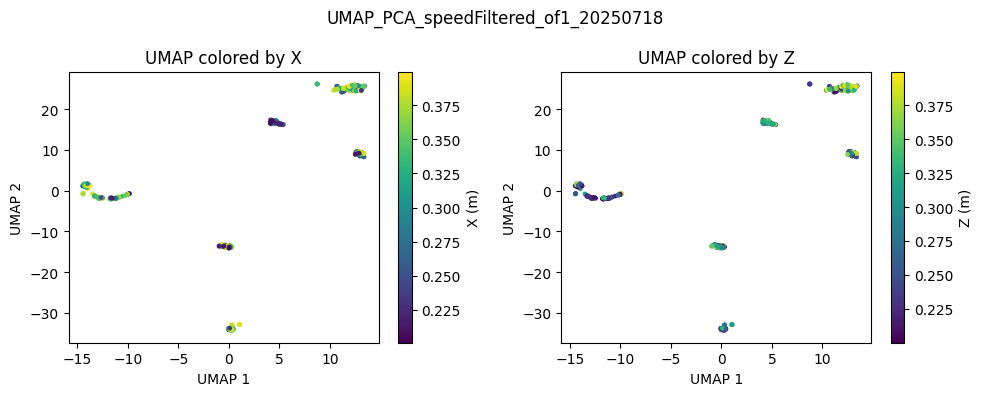

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


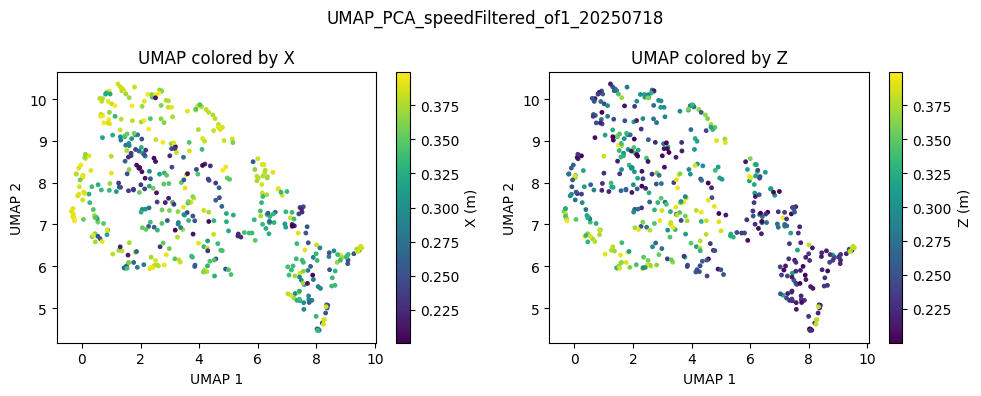

In [182]:
chopchop(of = 'of1', x_borders  = [0.2, 0.4], z_borders = [0.2,0.4])

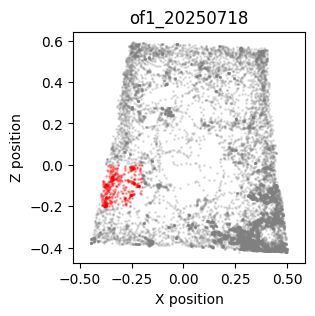

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


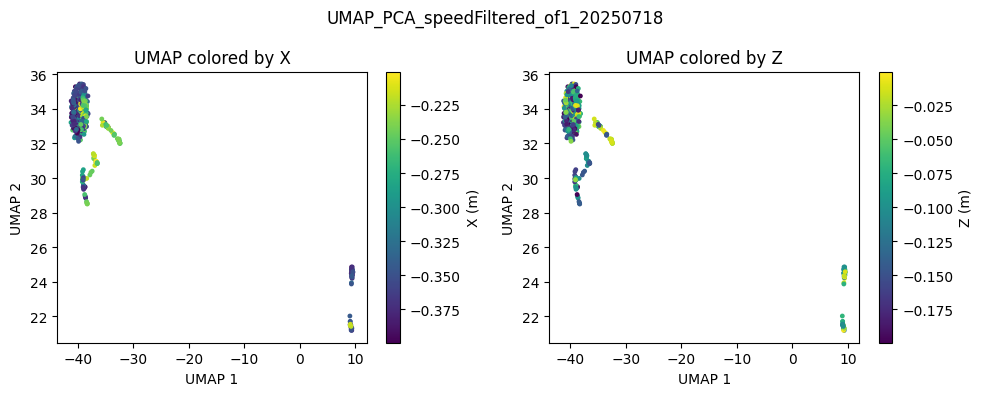

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


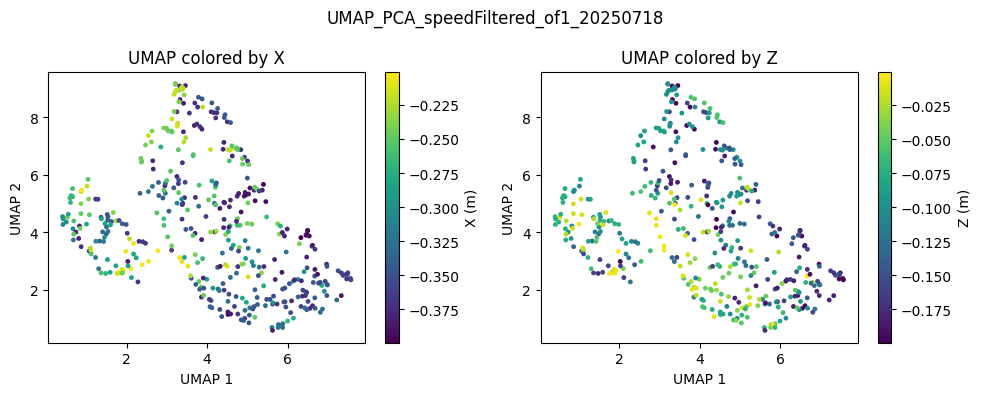

In [183]:
chopchop(of = 'of1', x_borders  = [-0.4, -0.2], z_borders = [-0.2,0.0])

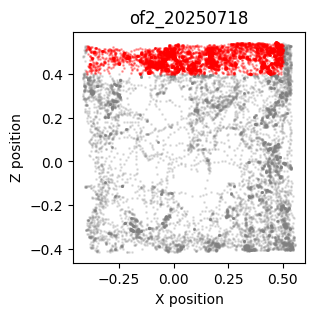

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


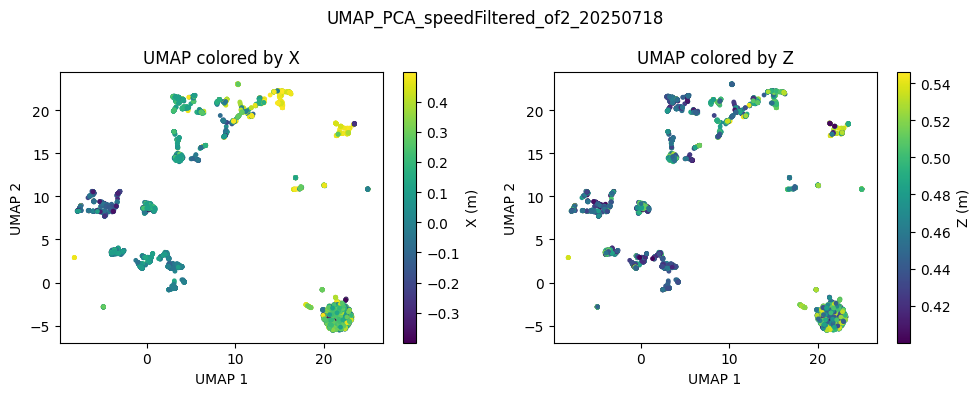

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


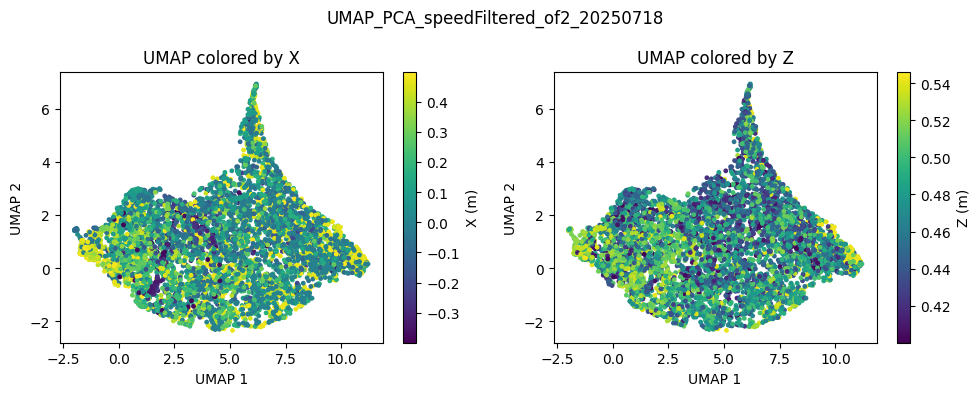

In [184]:
chopchop(of = 'of2', x_borders  = [-0.4, 0.5], z_borders = [0.4,0.6])

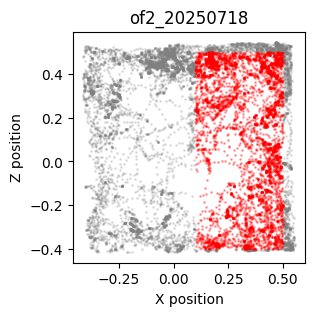

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


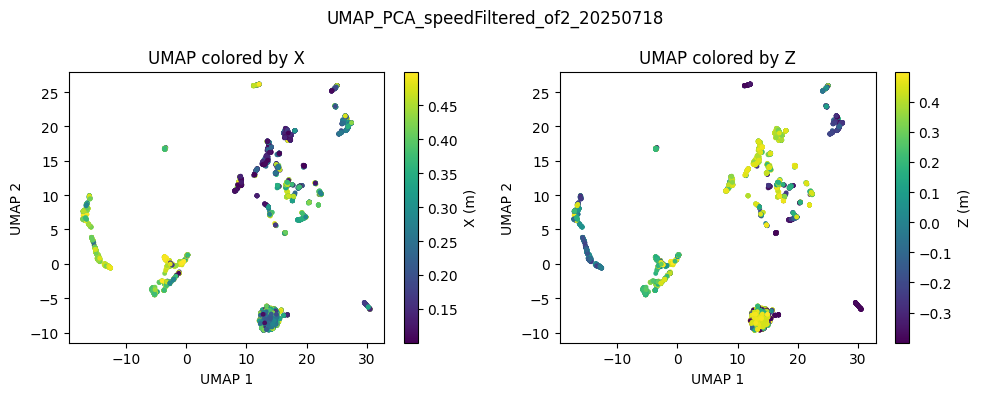

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


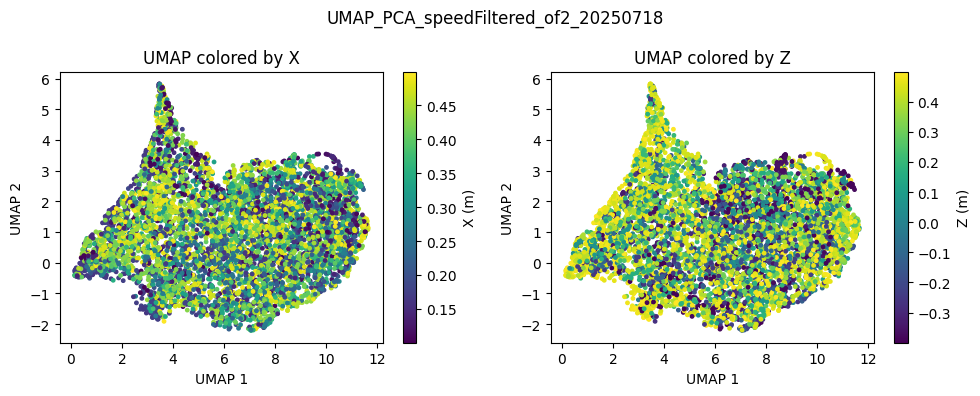

In [185]:
chopchop(of = 'of2', x_borders  = [0.1, 0.5], z_borders = [-0.4,0.5])

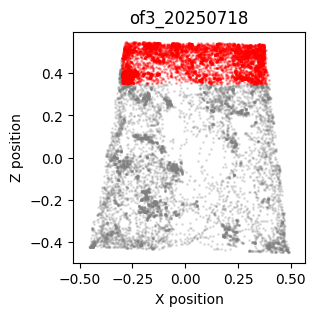

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


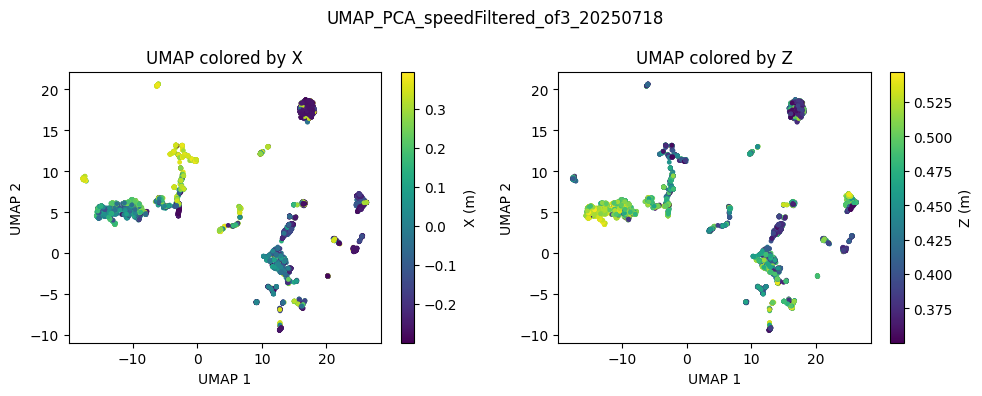

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


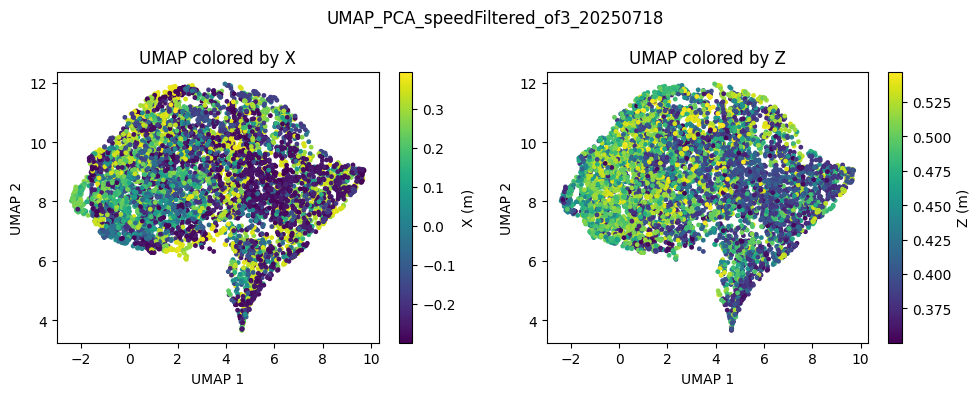

In [190]:
chopchop(of = 'of3', x_borders  = [-0.3, 0.4], z_borders = [0.35,0.6])

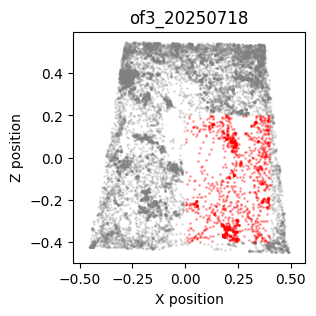

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


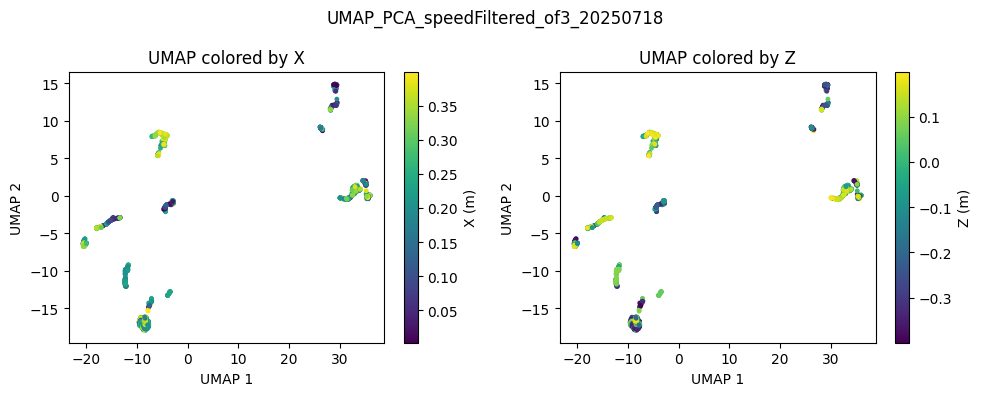

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


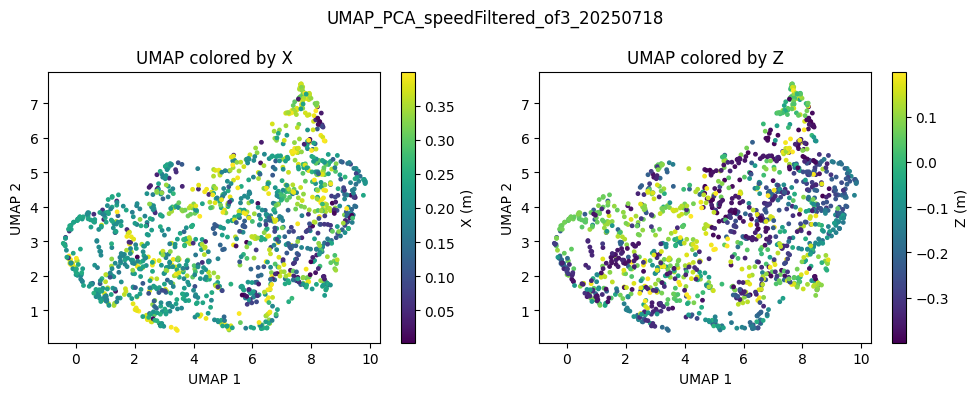

In [187]:
chopchop(of = 'of3', x_borders  = [0.0, 0.4], z_borders = [-0.4,0.2])

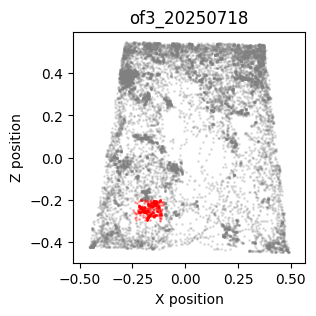

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


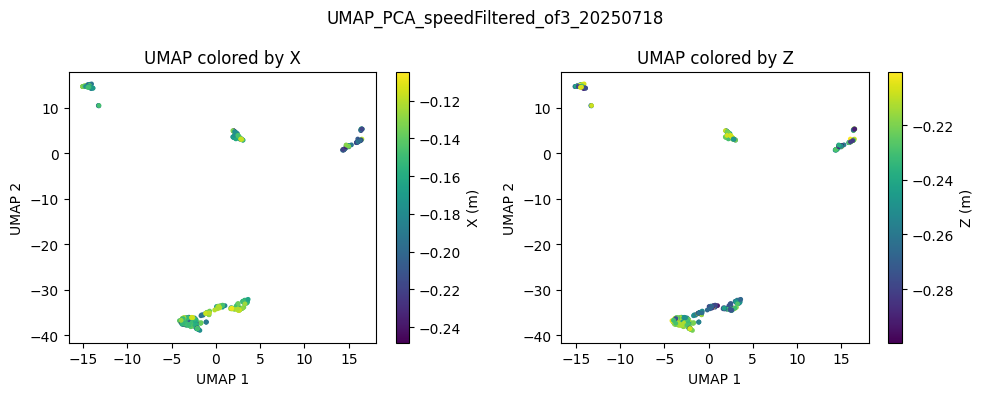

/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


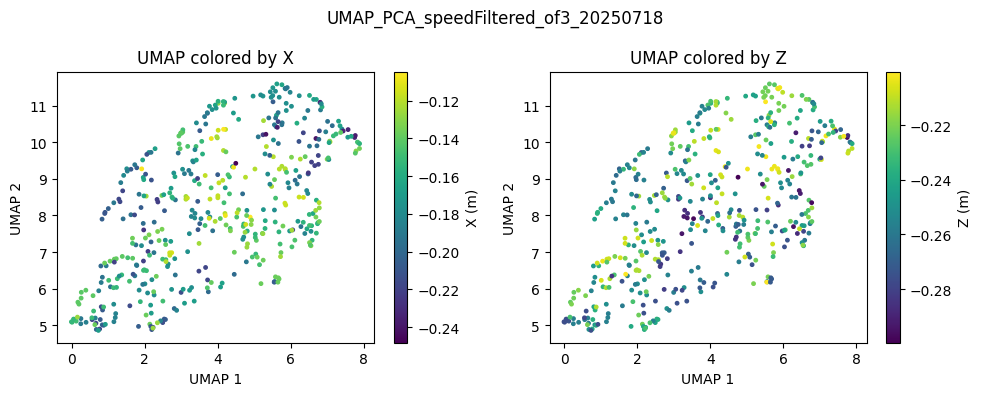

In [189]:
chopchop(of = 'of3', x_borders  = [-0.25, -0.10], z_borders = [-0.3,-0.2])

## Umap params


In [193]:
# n_neighbors_list = [10, 15, 30, 50, 80]
# min_dist_list = [0.0, 0.05, 0.1, 0.3, 0.5]
n_neighbors_list = [10, 30, 80]
min_dist_list = [0.0, 0.1, 0.5]
metric_list = ["euclidean", "cosine"]

nn=10, md=0.0, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


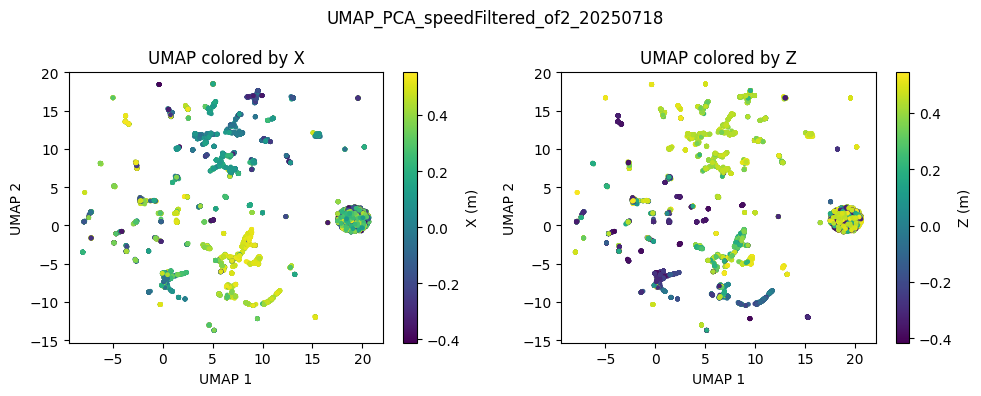

nn=10, md=0.0, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


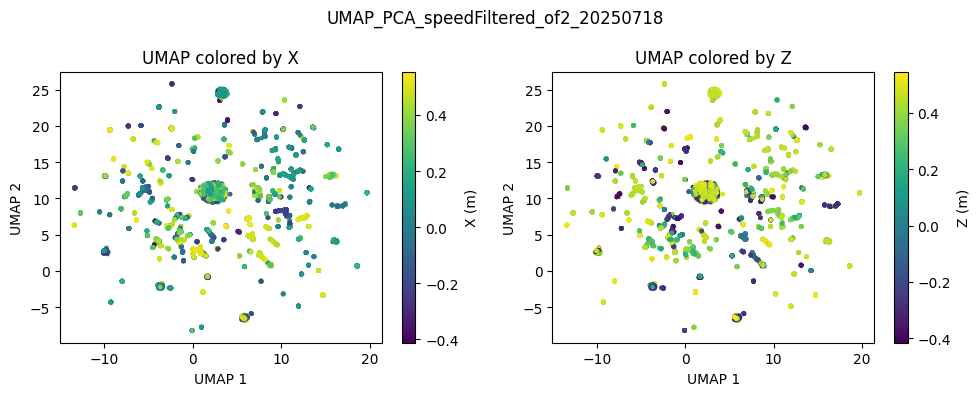

nn=10, md=0.1, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


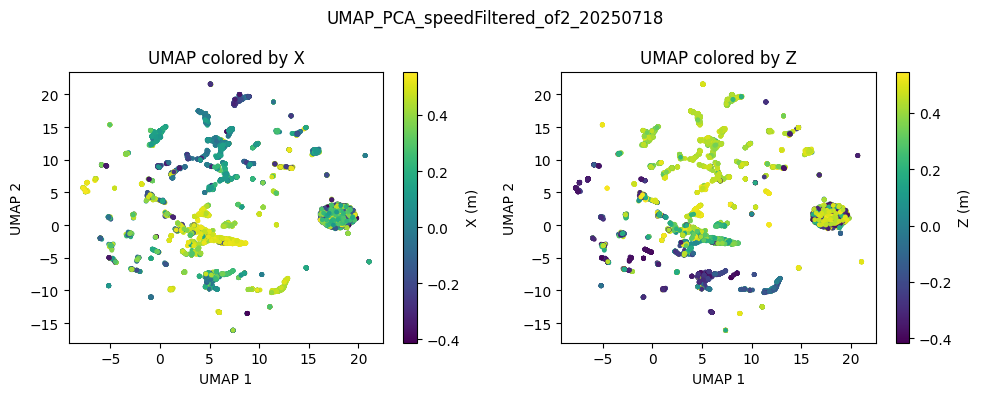

nn=10, md=0.1, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


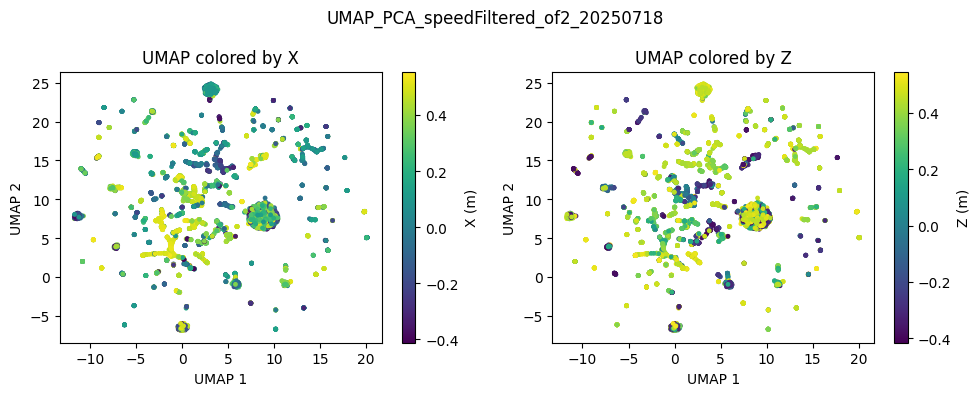

nn=10, md=0.5, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


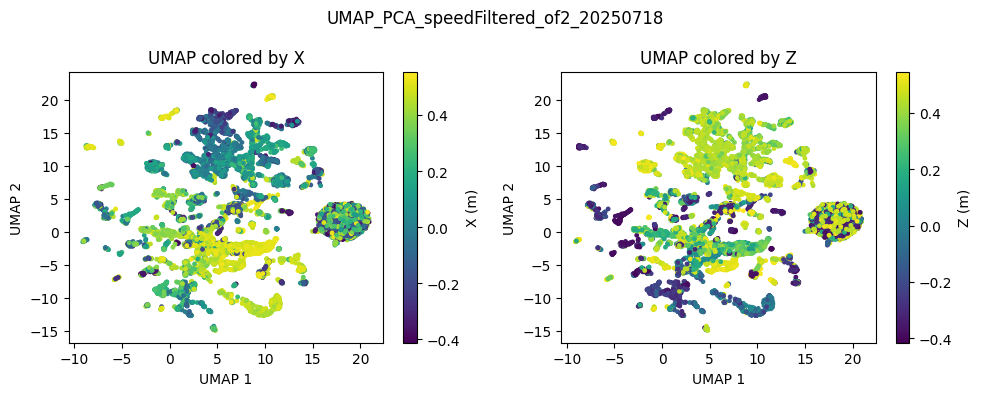

nn=10, md=0.5, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


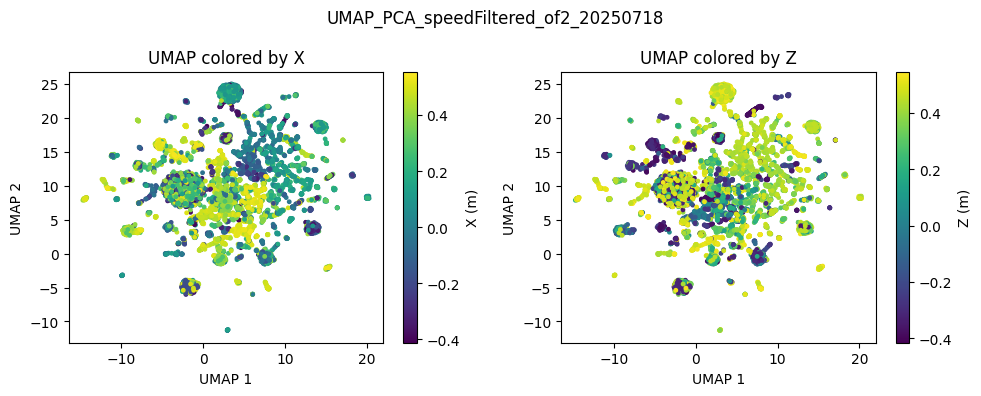

nn=30, md=0.0, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


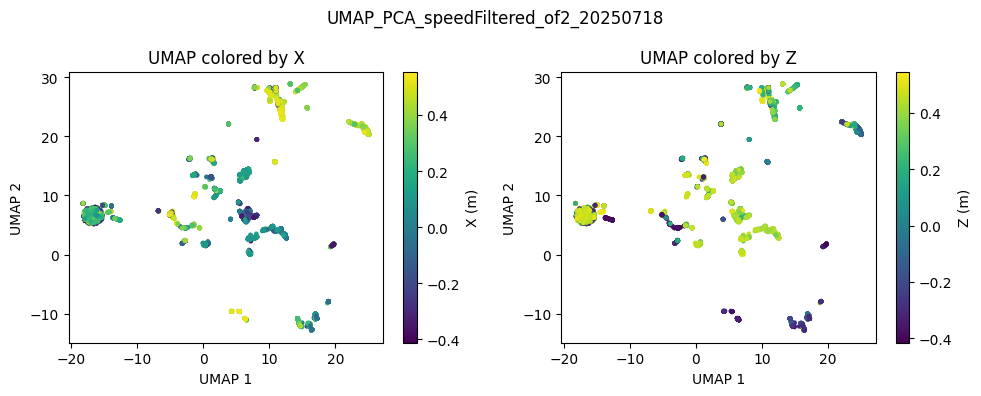

nn=30, md=0.0, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


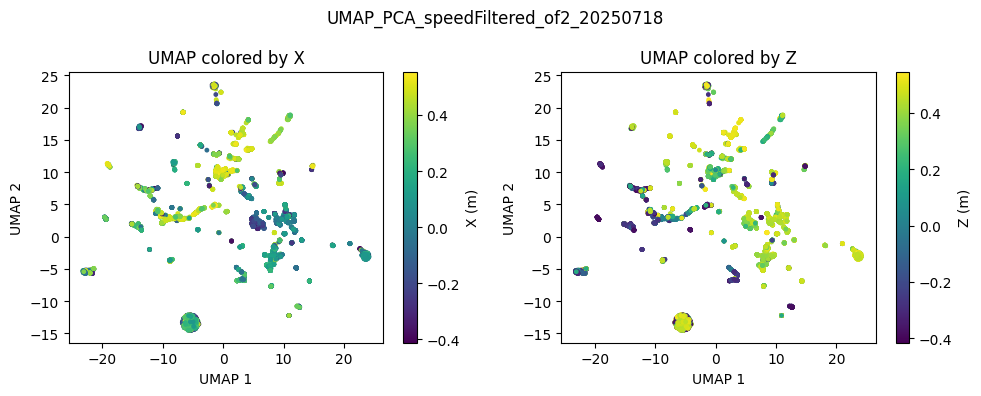

nn=30, md=0.1, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


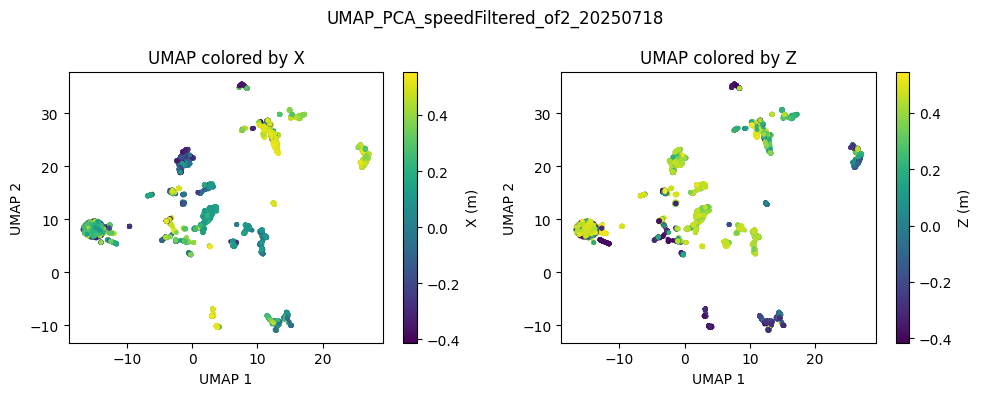

nn=30, md=0.1, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


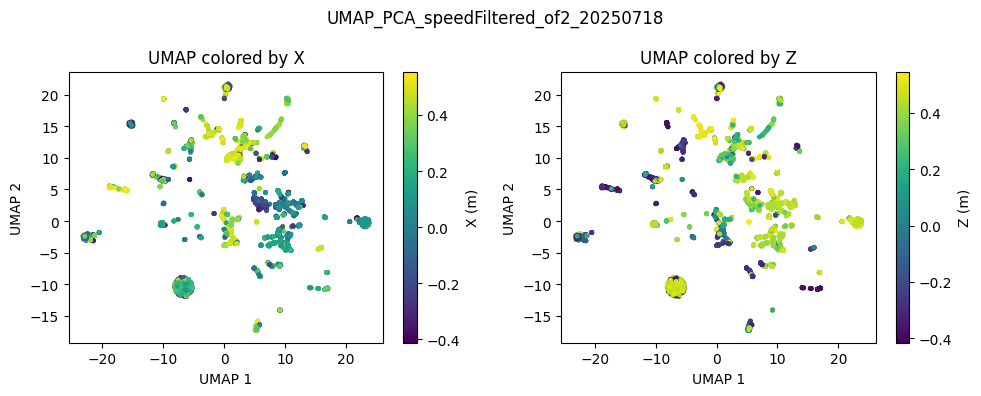

nn=30, md=0.5, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


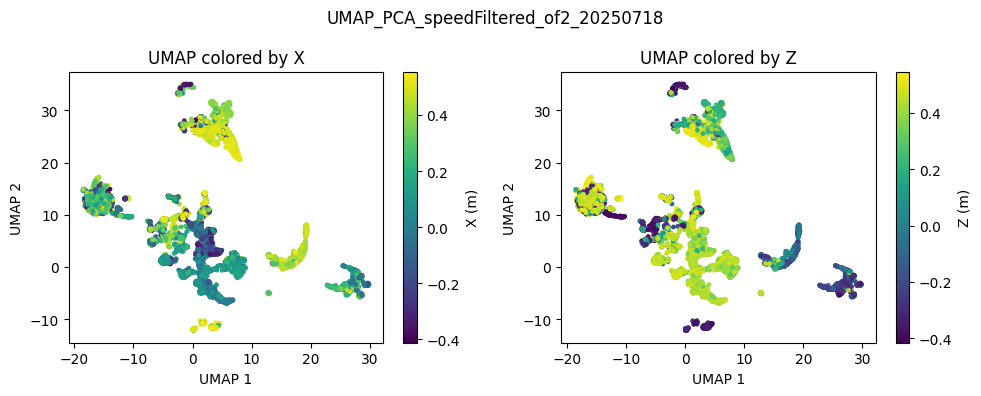

nn=30, md=0.5, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


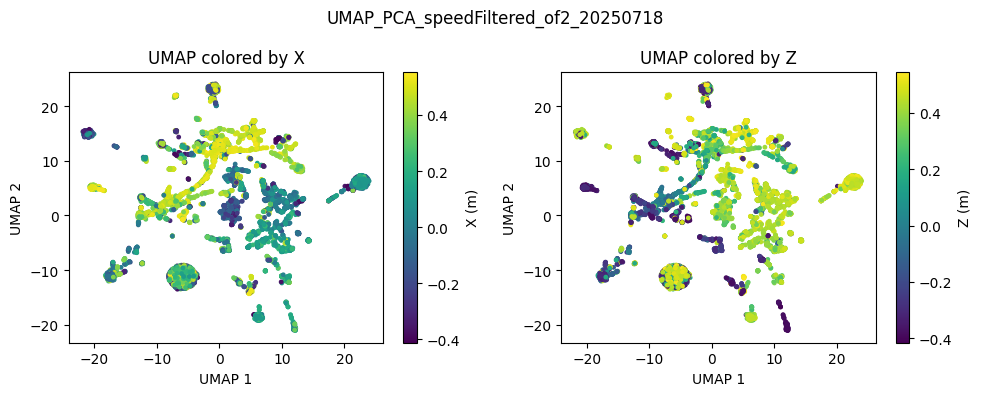

nn=80, md=0.0, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


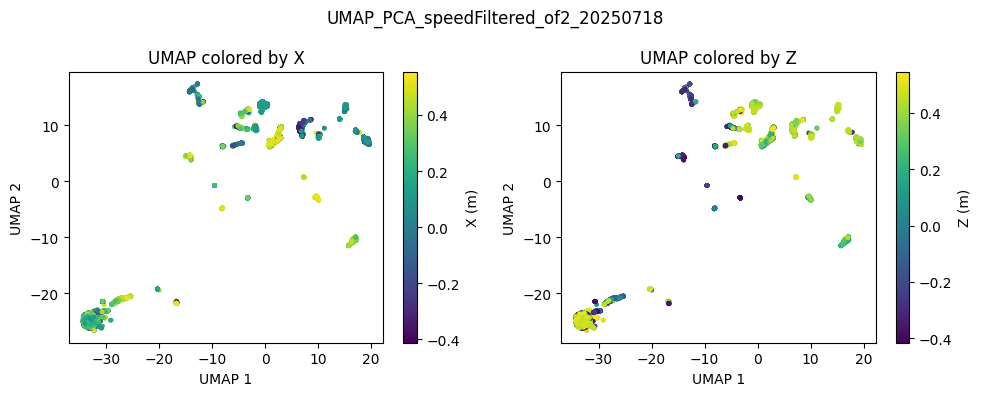

nn=80, md=0.0, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


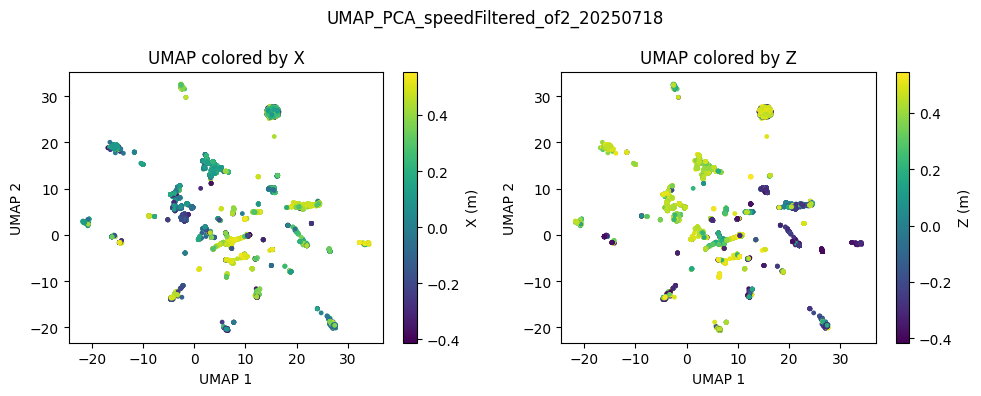

nn=80, md=0.1, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


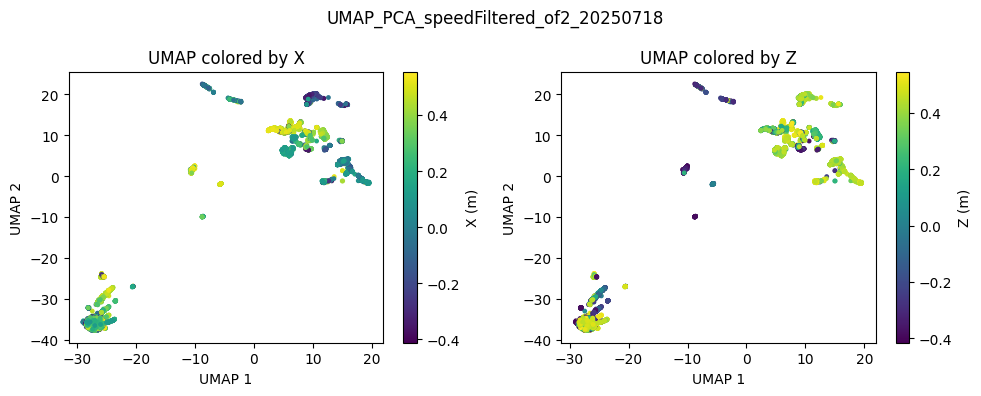

nn=80, md=0.1, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


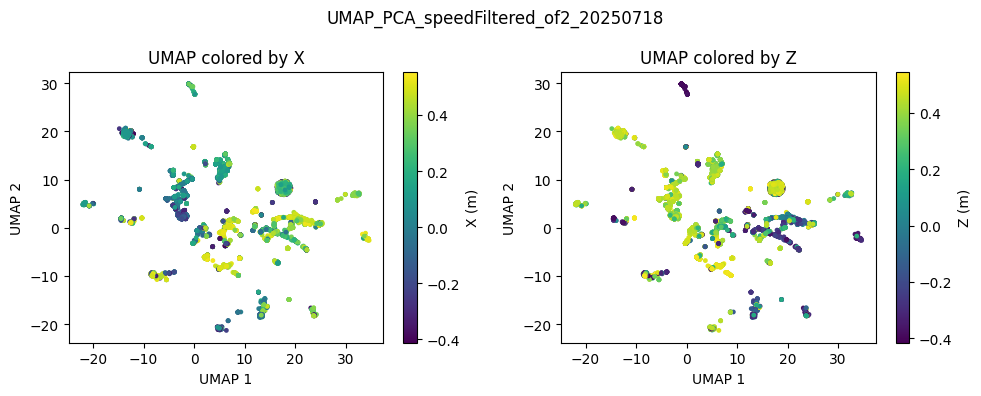

nn=80, md=0.5, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


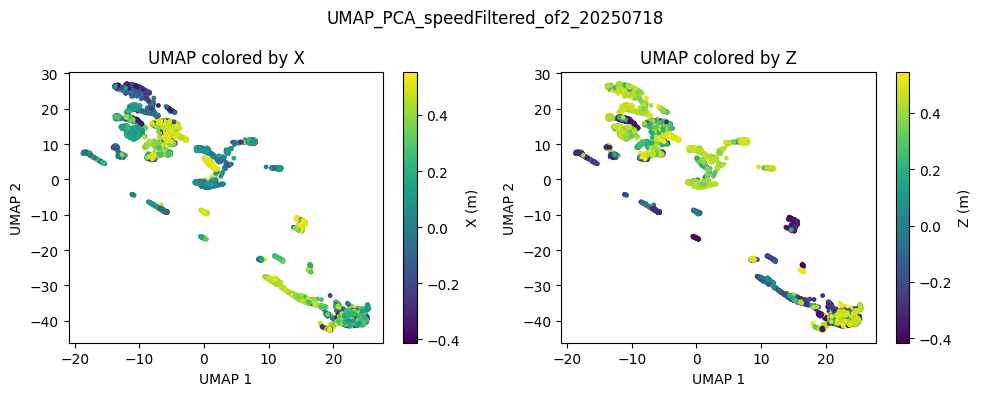

nn=80, md=0.5, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


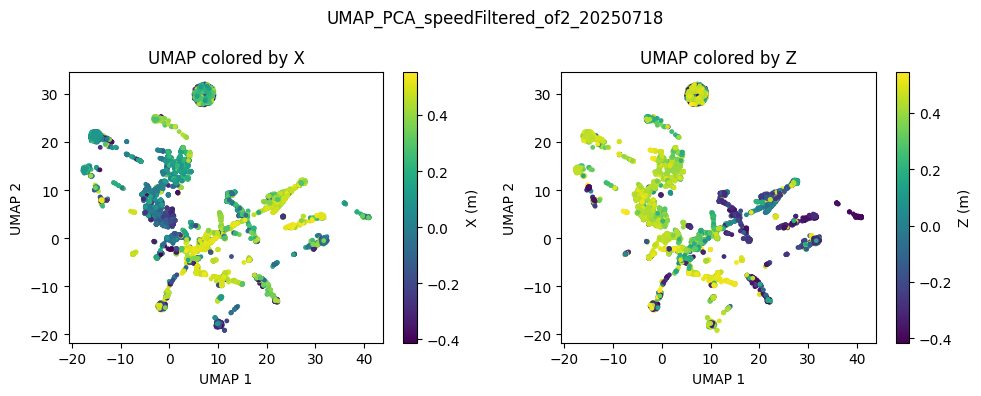

In [195]:
of = 'of2'
X_all = spike_matrix_run[of]
X_pyr = X_all[:, mask_pyr]
X_inter = X_all[:, mask_inter]

for nn in n_neighbors_list:
    for md in min_dist_list:
        for m in metric_list:
            print(f'nn={nn}, md={md}, m={m}')
            umap_kwargs=dict(n_neighbors=nn, min_dist=md, metric=m, random_state=42)
            get_umap(X_pyr, umap_kwargs=umap_kwargs, of=of, date=date, pos_dict=pos_data_run[of])

nn=10, md=0.0, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


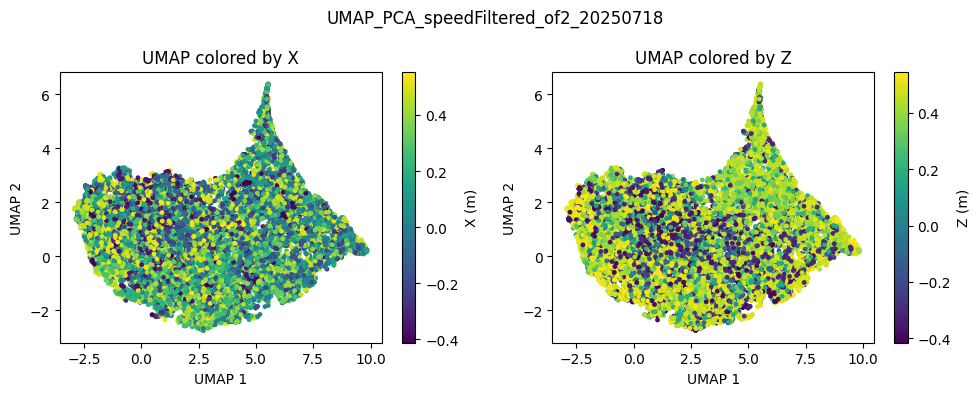

nn=10, md=0.0, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


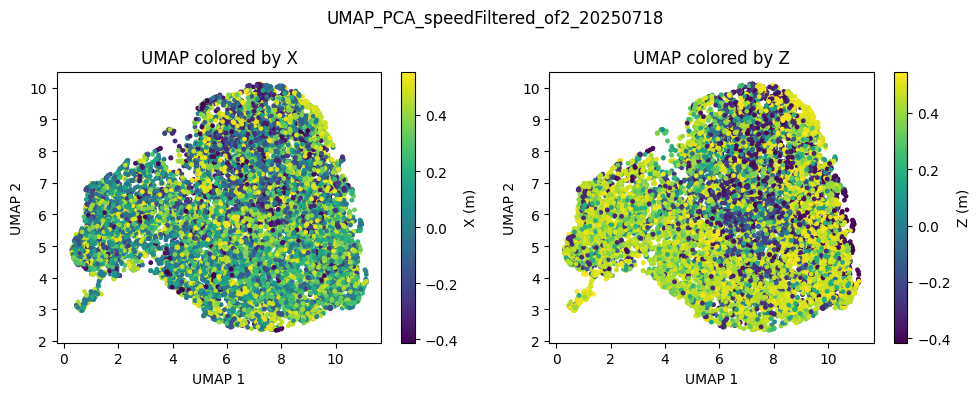

nn=10, md=0.1, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


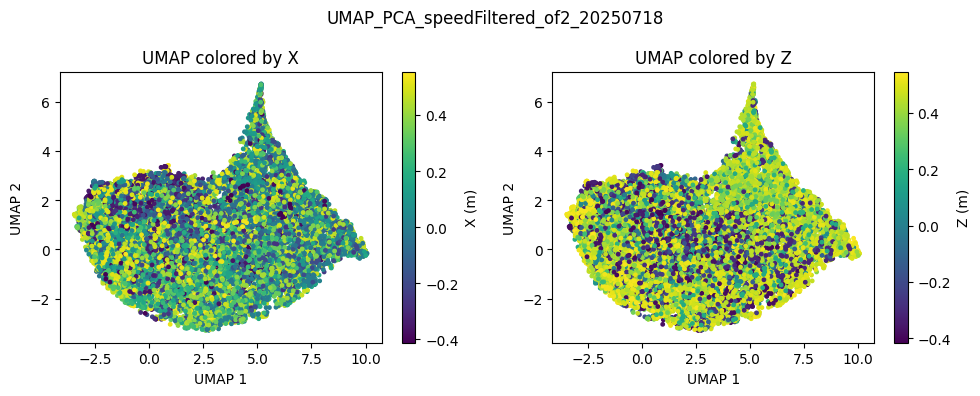

nn=10, md=0.1, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


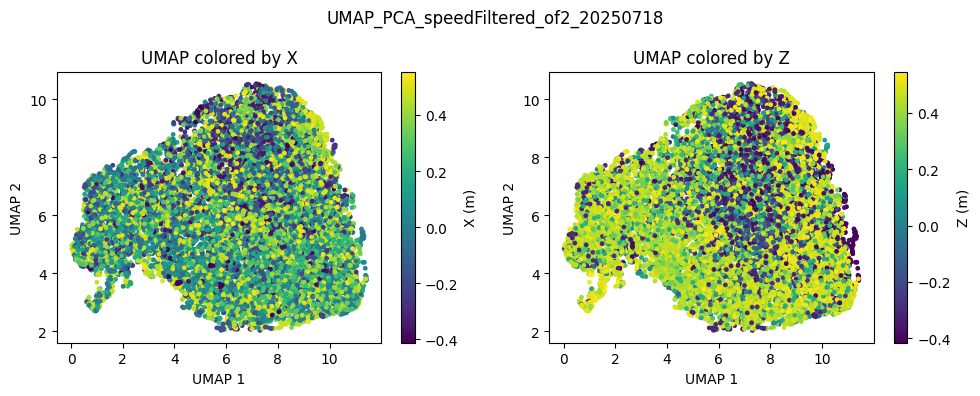

nn=10, md=0.5, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


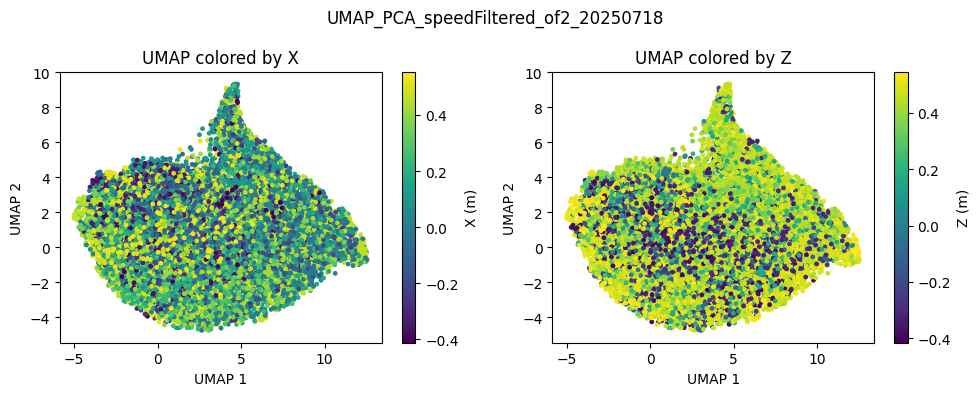

nn=10, md=0.5, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


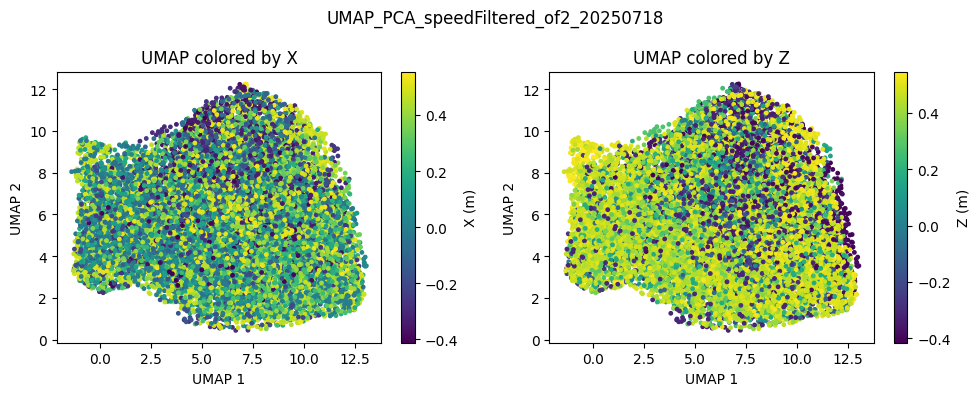

nn=30, md=0.0, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


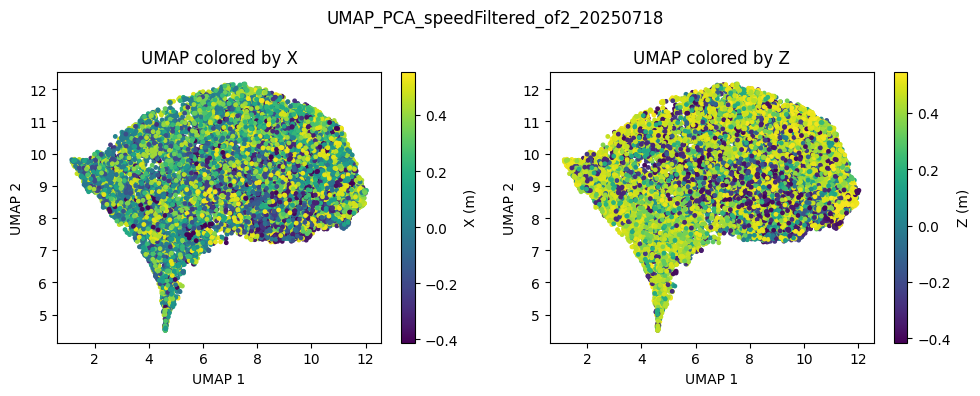

nn=30, md=0.0, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


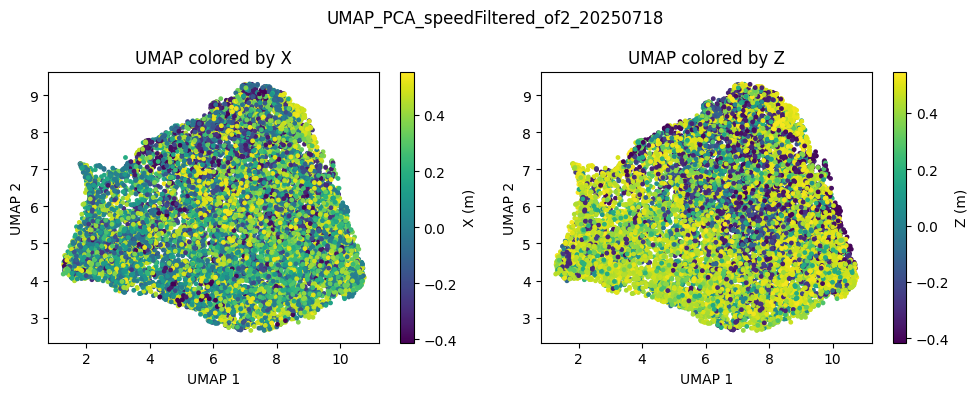

nn=30, md=0.1, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


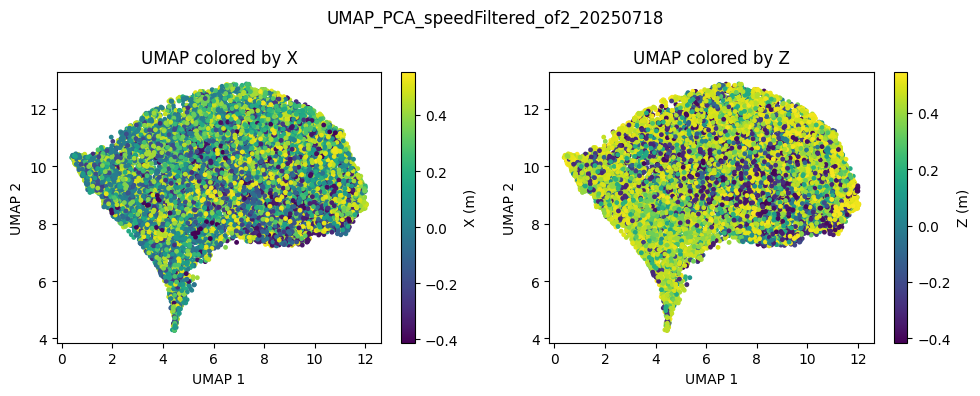

nn=30, md=0.1, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


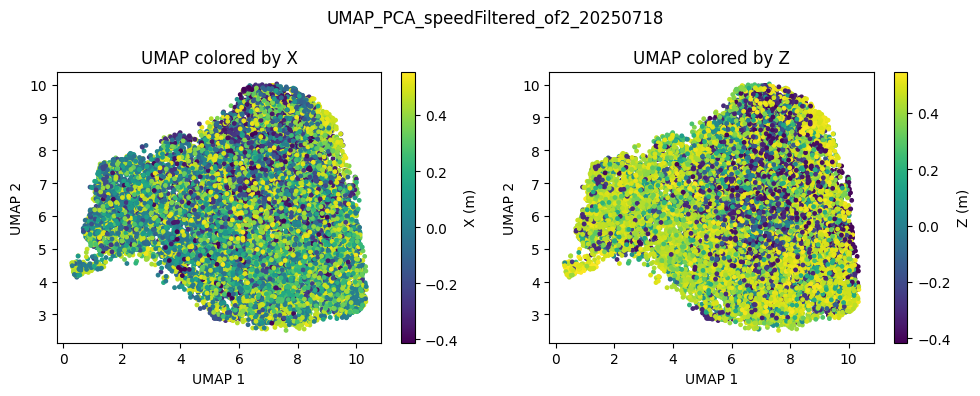

nn=30, md=0.5, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


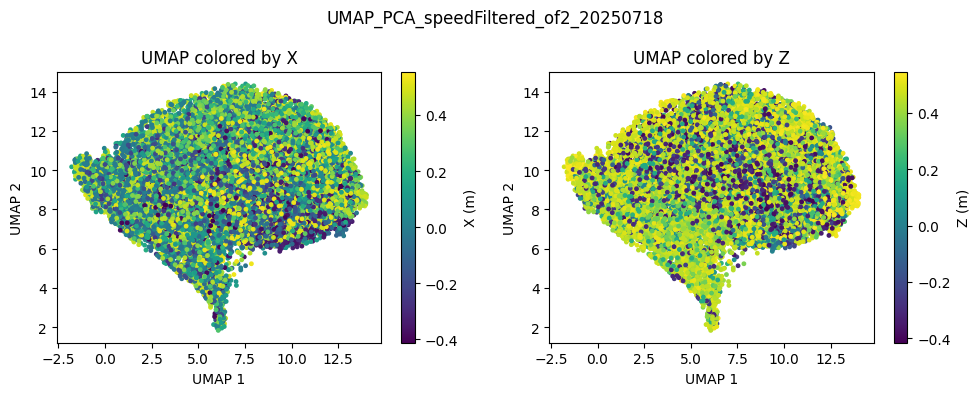

nn=30, md=0.5, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


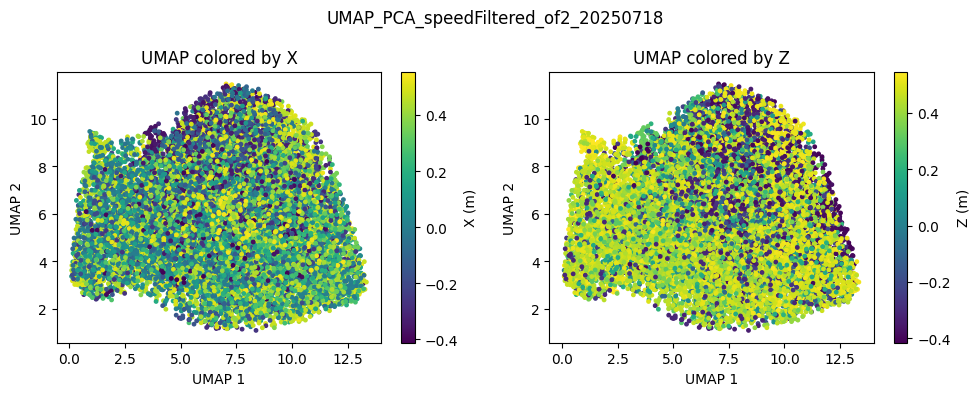

nn=80, md=0.0, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


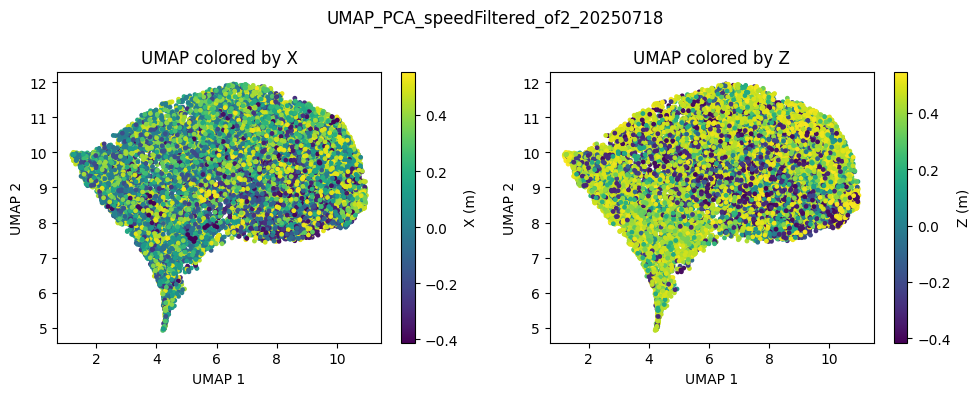

nn=80, md=0.0, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


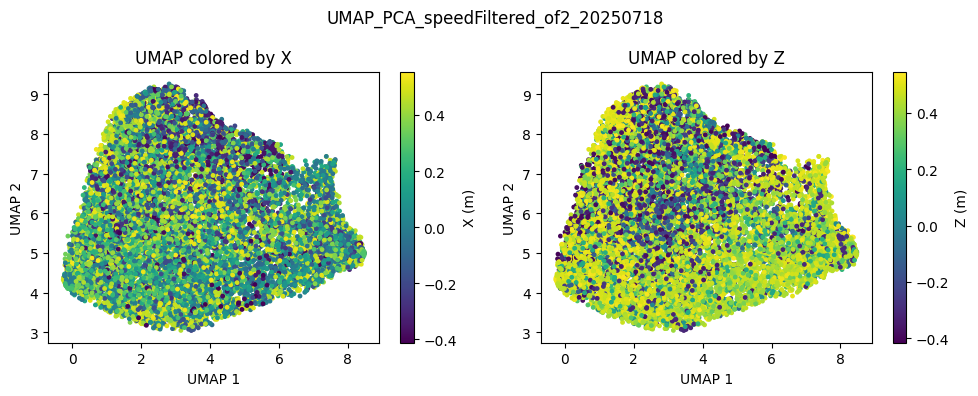

nn=80, md=0.1, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


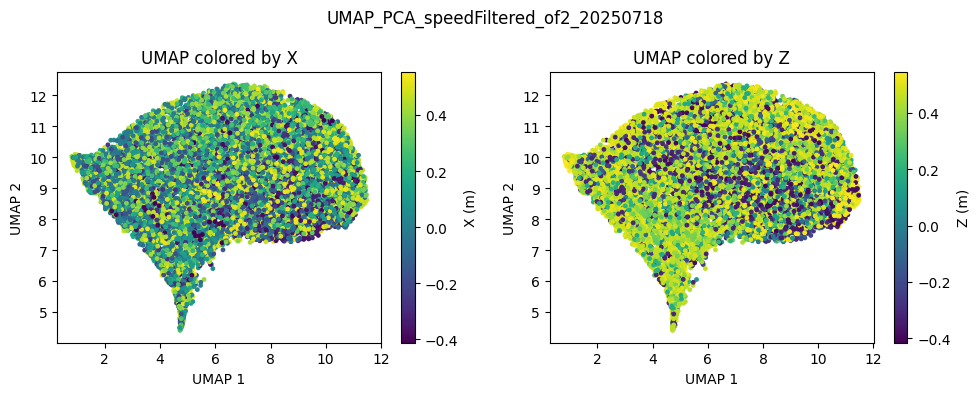

nn=80, md=0.1, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


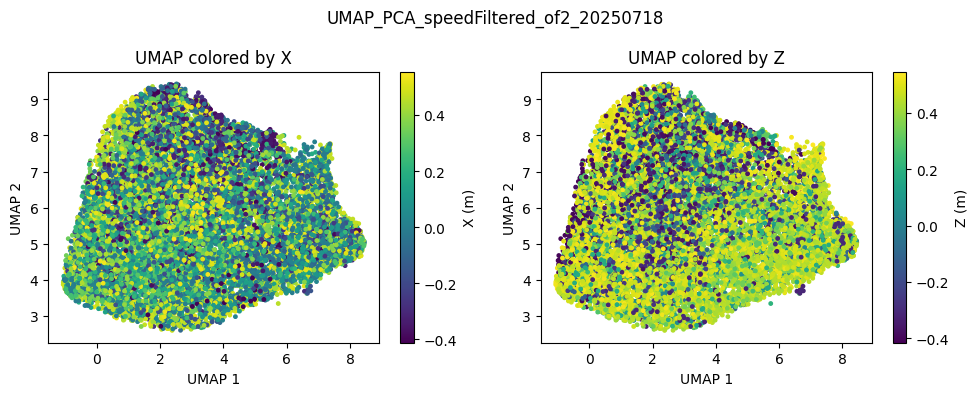

nn=80, md=0.5, m=euclidean


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


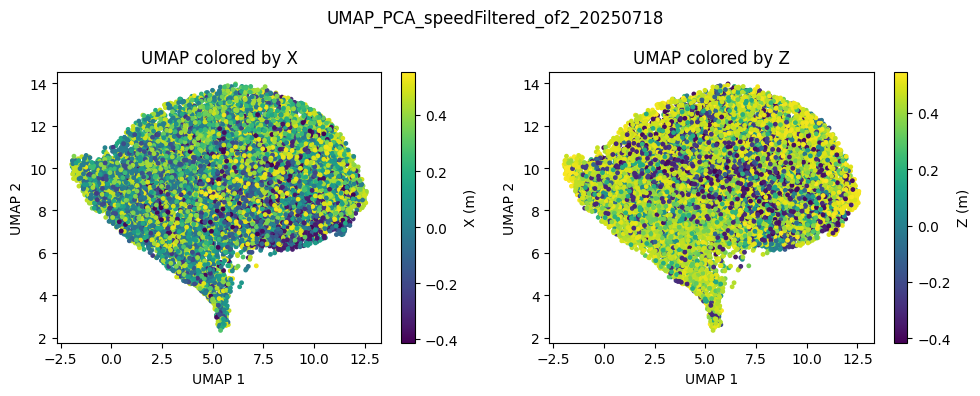

nn=80, md=0.5, m=cosine


/storage3/eva/apps/anaconda3/envs/nma/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


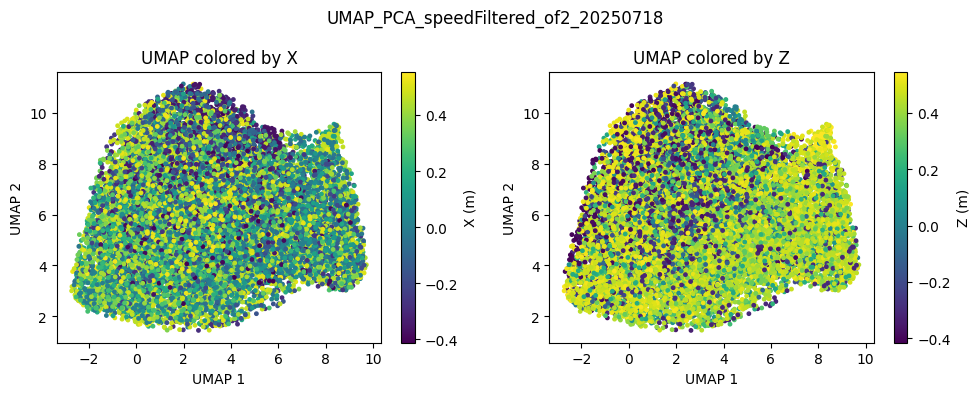

In [196]:
for nn in n_neighbors_list:
    for md in min_dist_list:
        for m in metric_list:
            print(f'nn={nn}, md={md}, m={m}')
            umap_kwargs=dict(n_neighbors=nn, min_dist=md, metric=m, random_state=42)
            get_umap(X_inter, umap_kwargs=umap_kwargs, of=of, date=date, pos_dict=pos_data_run[of])

## LP, HP, R supervised umap

- In UMAP, “training” means learning a transformation from high-dimensional space (e.g. 73 neurons) into a low-dimensional one (e.g. 2D), based on structure and labels.
- “Testing” means applying that transformation to new data to see where it lands in the learned map.

In [ ]:
# y_thresh = 0.15
# speed_cutoff = 0.02
# mask = (pos_data_resampled[of]['Y'] >= y_thresh) | (speeds[of] > speed_cutoff) # double mask
# spike_matrix_run
# pos_data_run
# pitch_run
# speeds_run

oke, i have : these arrays: 
- spike_matrix_run (keys 1st level: of1,of2,of3; shape=(14189, 73) where 73 - neurons; 14189 - time bins) 
- pos_data_run (keys: of1,of2,of3; keys 2nd level: X,Y,Z) 
- pitch_run (keys: of1,of2,of3) 
- speeds_run (keys: of1,of2,of3) 

- of1,of2,of3 - 3 open field runs for 30 mins 

they were obtained by applying this mask: 
- y_thresh = 0.15 # speed_cutoff = 0.02 
- mask = (pos_data_resampled[of]['Y'] >= y_thresh) | (speeds[of] > speed_cutoff) # double mask 
- in my setup y - height. so now i wanna split my data into 3 classes/groups: 
1. low pitch walk (speeds_run[of]>speed_cutoff & pitch_run[of]<-30) 
2. high pitch walk (speeds_run[of]>speed_cutoff & pitch_run[of]>-30) 
3. rearing (pos_data_resampled[of]['Y'] >= y_thresh) 

- A said we can pull data in general or use one maze for training another for testing... lets see

In [34]:
# Label time bins
'''
label array (shape = (14189,) per OF), where each bin gets:
0: low pitch walk
1: high pitch walk
2: rearing
'''

def get_behavior_labels(pitch, y, speed, y_thresh=0.15, speed_cutoff=0.02):
    labels = np.full_like(pitch, fill_value=-1, dtype=int)  # -1 = not classified
    
    is_rearing = y >= y_thresh
    is_low_pitch_walk  = (speed > speed_cutoff) & (pitch < -30)
    is_high_pitch_walk = (speed > speed_cutoff) & (pitch > -30)
    
    labels[is_low_pitch_walk]  = 0
    labels[is_high_pitch_walk] = 1
    labels[is_rearing]         = 2  # rearing overrides walking

    return labels

In [35]:
'''
Concatenate data
stack all spike_matrix_run[of] and their corresponding labels across of1, of2, of3.
'''

X_all = []   # neural activity
y_all = []   # labels
of_keys = ['of1', 'of2', 'of3']

for of in of_keys:
    X_of = spike_matrix_run[of]     # (14189, 73)
    pitch = pitch_run[of]
    y_pos = pos_data_run[of]['Y']
    speed = speeds_run[of]

    labels = get_behavior_labels(pitch, y_pos, speed)
    
    # only keep bins with labels (i.e. discard -1)
    valid_mask = labels != -1
    X_all.append(X_of[valid_mask])
    y_all.append(labels[valid_mask])

# Final arrays
X = np.vstack(X_all)
y = np.concatenate(y_all)

In [36]:
X.shape, y.shape

((50598, 67), (50598,))

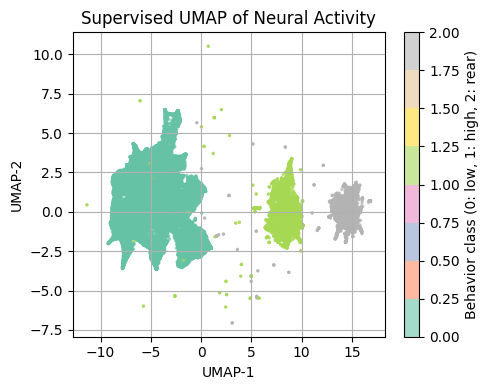

In [37]:
reducer = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=2, 
                    metric='euclidean', target_metric='categorical')
embedding = reducer.fit_transform(X, y)

# Plot
plt.figure(figsize=(5, 4))
scatter = plt.scatter(embedding[:, 0], embedding[:, 1], c=y, cmap='Set2', s=2, alpha=0.6)
plt.title('Supervised UMAP of Neural Activity')
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.colorbar(scatter, label='Behavior class (0: low, 1: high, 2: rear)')
plt.grid(True)
plt.tight_layout()
plt.show()

now do proper test-train split

In [38]:
train_ofs = ['of1', 'of2']
test_ofs = ['of3']

In [39]:
X_trains = []
y_trains = []

for of in train_ofs:
    pitch = pitch_run[of]
    y_pos = pos_data_run[of]['Y']
    speed = speeds_run[of]
    labels = get_behavior_labels(pitch, y_pos, speed)
    
    valid_mask = labels != -1
    X_trains.append(spike_matrix_run[of][valid_mask])
    y_trains.append(labels[valid_mask])

    # emb_train = reducer.transform(X_test)

    # X_tests.append(emb_test)
    # y_tests.append(y_test)
    # origin_ofs.extend([of] * len(y_test))

try:
    X_trains = np.vstack(X_trains)
    X_trains = np.array(X_trains)

    y_trains = np.hstack(y_trains)
    y_trains = np.array(y_trains)
except:
    X_trains = np.array(X_trains)
    y_trains = np.array(y_trains)

X_trains.shape, y_trains.shape

((34881, 67), (34881,))

In [40]:
X_tests = []
y_tests = []

for of in test_ofs:
    pitch = pitch_run[of]
    y_pos = pos_data_run[of]['Y']
    speed = speeds_run[of]
    labels = get_behavior_labels(pitch, y_pos, speed)
    
    valid_mask = labels != -1
    X_tests.append(spike_matrix_run[of][valid_mask])
    y_tests.append(labels[valid_mask])

try:
    X_tests = np.vstack(X_tests)
    X_tests = np.array(X_tests)

    y_tests = np.hstack(y_tests)
    y_tests = np.array(y_tests)
except:
    X_tests = np.array(X_tests)
    y_tests = np.array(y_tests)

X_tests.shape, y_tests.shape

((15717, 67), (15717,))

In [41]:
reducer = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=2, metric='euclidean', target_metric='categorical')

In [42]:
embedding_train = reducer.fit_transform(X_trains, y_trains)

In [43]:
embedding_test = reducer.transform(X_tests)

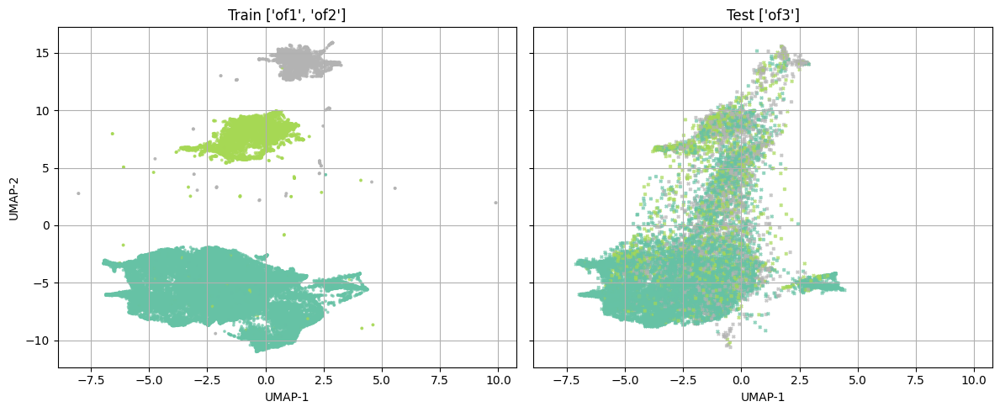

In [44]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5), sharex=True, sharey=True)

# Left: training set
axs[0].scatter(embedding_train[:, 0], embedding_train[:, 1], 
               c=y_trains, cmap='Set2', s=3, alpha=0.6)
axs[0].set_title(f'Train {train_ofs}')
axs[0].set_xlabel('UMAP-1')
axs[0].set_ylabel('UMAP-2')
axs[0].grid(True)

# Right: test set
axs[1].scatter(embedding_test[:, 0], embedding_test[:, 1], 
               c=y_tests, cmap='Set2', s=6, alpha=0.7, marker='x')
axs[1].set_title(f'Test {test_ofs}')
axs[1].set_xlabel('UMAP-1')
axs[1].grid(True)

plt.tight_layout()
plt.show()

In [45]:
inter_indices = [all.index(i) for i in inter if i in all]
pyr_indices = [all.index(i) for i in pyr if i in all]
inter_indices

[3, 19, 11, 12, 18, 51, 13, 10, 14, 4]

In [46]:
X_train_inter = X_trains[:, inter_indices]
X_test_inter = X_tests[:, inter_indices]

In [47]:
reducer_inter = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=2, metric='euclidean', target_metric='categorical')
embedding_train_inter = reducer_inter.fit_transform(X_train_inter, y_trains)
embedding_test_inter = reducer_inter.transform(X_test_inter)


In [48]:
embedding_train_inter.shape

(34881, 2)

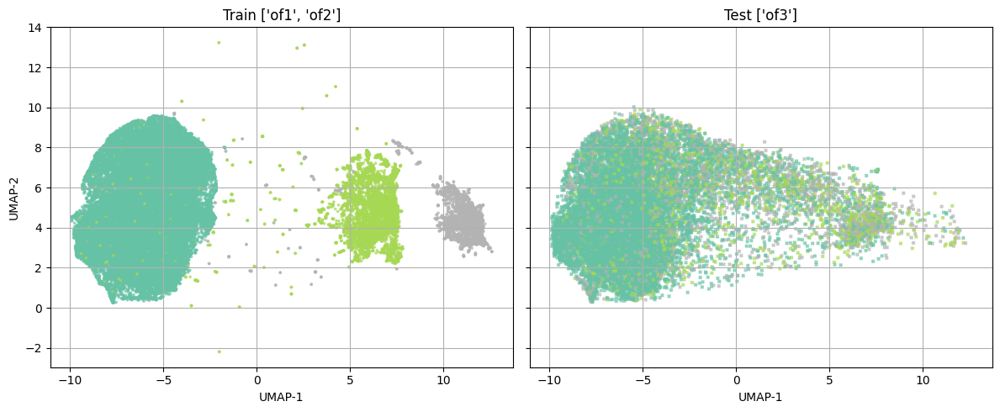

In [49]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5), sharex=True, sharey=True)

# Left: training set
axs[0].scatter(embedding_train_inter[:, 0], embedding_train_inter[:, 1], 
               c=y_trains, cmap='Set2', s=3, alpha=0.6)
axs[0].set_title(f'Train {train_ofs}')
axs[0].set_xlabel('UMAP-1')
axs[0].set_ylabel('UMAP-2')
axs[0].grid(True)

# Right: test set
axs[1].scatter(embedding_test_inter[:, 0], embedding_test_inter[:, 1], 
               c=y_tests, cmap='Set2', s=6, alpha=0.7, marker='x')
axs[1].set_title(f'Test {test_ofs}')
axs[1].set_xlabel('UMAP-1')
axs[1].grid(True)

plt.tight_layout()
plt.show()

pyr

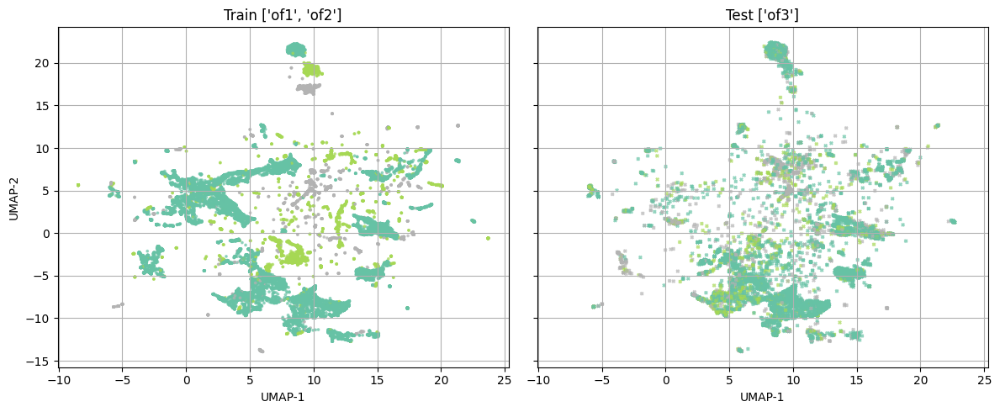

In [50]:
X_train_inter = X_trains[:, pyr_indices]
X_test_inter = X_tests[:, pyr_indices]


reducer_inter = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=2, metric='euclidean', target_metric='categorical')
embedding_train_inter = reducer_inter.fit_transform(X_train_inter, y_trains)
embedding_test_inter = reducer_inter.transform(X_test_inter)

fig, axs = plt.subplots(1, 2, figsize=(12, 5), sharex=True, sharey=True)

# Left: training set
axs[0].scatter(embedding_train_inter[:, 0], embedding_train_inter[:, 1], 
               c=y_trains, cmap='Set2', s=3, alpha=0.6)
axs[0].set_title(f'Train {train_ofs}')
axs[0].set_xlabel('UMAP-1')
axs[0].set_ylabel('UMAP-2')
axs[0].grid(True)

# Right: test set
axs[1].scatter(embedding_test_inter[:, 0], embedding_test_inter[:, 1], 
               c=y_tests, cmap='Set2', s=6, alpha=0.7, marker='x')
axs[1].set_title(f'Test {test_ofs}')
axs[1].set_xlabel('UMAP-1')
axs[1].grid(True)

plt.tight_layout()
plt.show()

In [51]:
reducer_inter = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=3, metric='euclidean', target_metric='categorical')

In [52]:
embedding_train_inter = reducer_inter.fit_transform(X_train_inter, y_trains)
embedding_test_inter = reducer_inter.transform(X_test_inter)

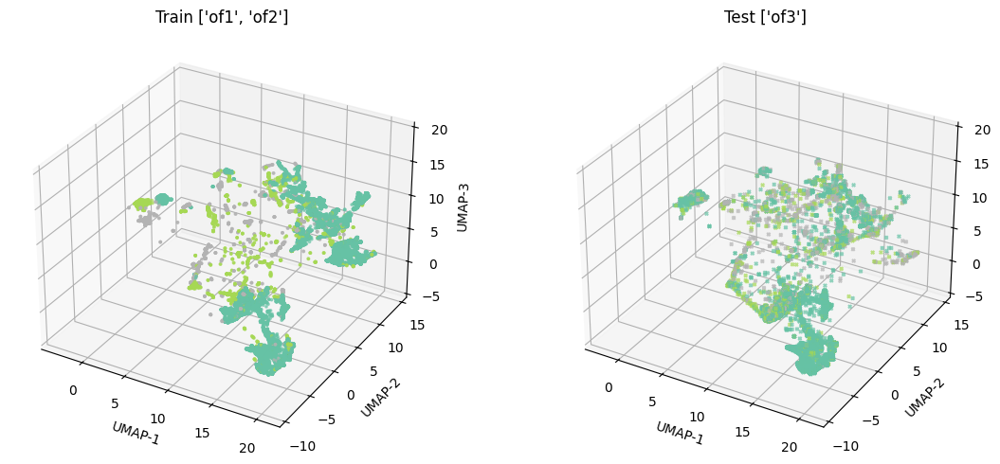

In [53]:
from mpl_toolkits.mplot3d import Axes3D 
fig = plt.figure(figsize=(12, 5))

# Left: 3D Train
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
sc1 = ax1.scatter(embedding_train_inter[:, 0], embedding_train_inter[:, 1], embedding_train_inter[:, 2],
                  c=y_trains, cmap='Set2', s=3, alpha=0.6)
ax1.set_title(f'Train {train_ofs}')
ax1.set_xlabel('UMAP-1')
ax1.set_ylabel('UMAP-2')
ax1.set_zlabel('UMAP-3')

# Right: 3D Test
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
sc2 = ax2.scatter(embedding_test_inter[:, 0], embedding_test_inter[:, 1], embedding_test_inter[:, 2],
                  c=y_tests, cmap='Set2', s=6, alpha=0.7, marker='x')
ax2.set_title(f'Test {test_ofs}')
ax2.set_xlabel('UMAP-1')
ax2.set_ylabel('UMAP-2')
ax2.set_zlabel('UMAP-3')

plt.tight_layout()
plt.show()

In [54]:
# try data within 1 maze

of = 'of1'

pitch = pitch_run[of]
y_pos = pos_data_run[of]['Y']
speed = speeds_run[of]
labels = get_behavior_labels(pitch, y_pos, speed)

valid_mask = labels != -1
X_train = spike_matrix_run[of][valid_mask]
y_train = labels[valid_mask]

X_train.shape, y_train.shape

((17344, 67), (17344,))

In [55]:
# Step 1: total length
n = X_train.shape[0]

# Step 2: compute middle 20%
start = int(n * 0.3)
end   = int(n * 0.7)

# Step 3: slice
X_middle = X_train[start:end]
y_middle = y_train[start:end]

X_head = X_train[:start]
y_head = y_train[:start]

X_tail = X_train[end:]
y_tail = y_train[end:]

# Step 4: concatenate head + tail for training
X_train_sub = np.concatenate([X_head, X_tail], axis=0)
y_train_sub = np.concatenate([y_head, y_tail], axis=0)

# Step 5: middle for test
X_test_sub = X_middle
y_test_sub = y_middle

# step 6: take only inter
X_train_sub = X_train_sub[:, inter_indices]
X_test_sub = X_test_sub[:, inter_indices]

X_train_sub.shape, y_train_sub.shape, X_test_sub.shape, y_test_sub.shape

((10407, 10), (10407,), (6937, 10), (6937,))

In [56]:
np.unique(y_test_sub)

array([0, 1, 2])

In [57]:
reducer_inter = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=3, metric='euclidean', target_metric='categorical')

In [58]:
embedding_train_inter = reducer_inter.fit_transform(X_train_sub, y_train_sub)
embedding_test_inter = reducer_inter.transform(X_test_sub)

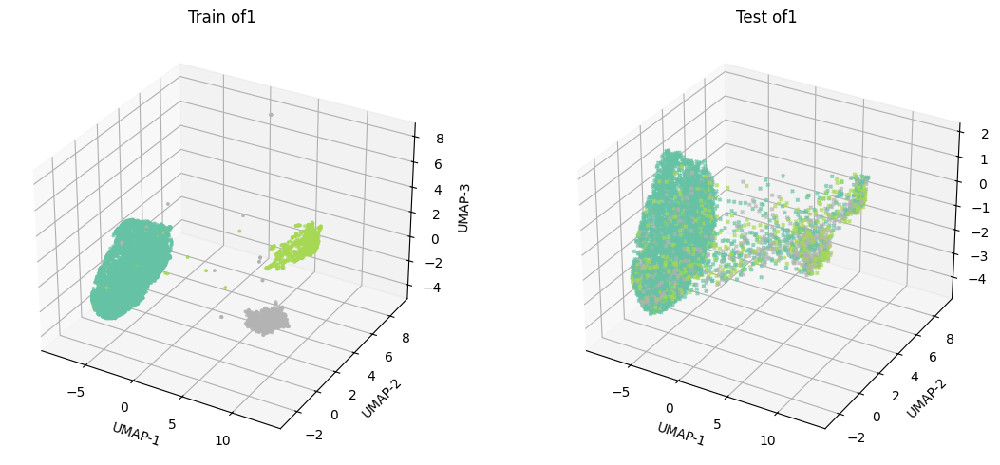

In [59]:
from mpl_toolkits.mplot3d import Axes3D 
fig = plt.figure(figsize=(12, 5))

# Left: 3D Train
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
sc1 = ax1.scatter(embedding_train_inter[:, 0], embedding_train_inter[:, 1], embedding_train_inter[:, 2],
                  c=y_train_sub, cmap='Set2', s=3, alpha=0.6)
ax1.set_title(f'Train {of}')
ax1.set_xlabel('UMAP-1')
ax1.set_ylabel('UMAP-2')
ax1.set_zlabel('UMAP-3')

# Right: 3D Test
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
sc2 = ax2.scatter(embedding_test_inter[:, 0], embedding_test_inter[:, 1], embedding_test_inter[:, 2],
                  c=y_test_sub, cmap='Set2', s=6, alpha=0.7, marker='x')
ax2.set_title(f'Test {of}')
ax2.set_xlabel('UMAP-1')
ax2.set_ylabel('UMAP-2')
ax2.set_zlabel('UMAP-3')

plt.tight_layout()
plt.show()